# Introduction

This file is meant to evaluate and extract explanations of the DARWIN dataset using the Stratified K-Fold with 10 train/test partitions (each train/test partition covers all the dataset). In each partition, the classifiers are trained with the few alterations of the default hyperparameters. This file is useful to get a better ideia of the real performance of the models by reducing the impact of randomness that a single train/test partition may cause.

Note: The complete run of this file should take 1.5-3 hours.

# Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import lime.lime_tabular
import shap
from interpret.glassbox import ExplainableBoostingClassifier
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.metrics import confusion_matrix
from PerformanceAnalysis import PerformanceAnalysis
from Visualization import Visualization
import os

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Setup

In [2]:
config_file = open('configs\\config.json')
config_vars = json.load(config_file)
config_file.close()

logs_dir = config_vars["logs_dir"] + "/darwin_baseline_CV"
dataset_dir = config_vars["dataset_dir"] + "/DARWIN.csv"

if not os.path.exists(logs_dir):
    os.makedirs(logs_dir)

In [3]:
config_file = open('configs\\visual_config.json')
visual_vars = json.load(config_file)
config_file.close()

shap_colors_neg = visual_vars["shap_colors"]["negative"]
shap_colors_pos = visual_vars["shap_colors"]["positive"]
shap_colors = np.array([tuple(shap_colors_neg), tuple(shap_colors_pos)])

title_size = visual_vars["title_font_size"]
label_size = visual_vars["labels_font_size"]

green_color = tuple([x/255 for x in visual_vars["green_colors"]["c2"]])

# Get Dataset

In [4]:
dataset = pd.read_csv(dataset_dir, header=0)
X = dataset.iloc[:, :-1]
y = dataset.iloc[:, -1]

In [5]:
X = X.drop(columns=["ID"])
features_names = X.columns

In [6]:
# Convert from pandas to numpy and turn into a 1D array
y = y.to_numpy().ravel()
y = np.array([0 if x == 'H' else 1 for x in y])

In [7]:
sss_nsplits = 10
sss = StratifiedShuffleSplit(n_splits=sss_nsplits, test_size=0.2, random_state=42)

lr_clfs = []
lr_limes = []
lr_shaps = []
rf_clfs = []
rf_limes = []
rf_shaps = []
svm_clfs = []
svm_limes = []
svm_shaps = []
ebm_clfs = []

In [8]:
X_trains_pd = []
X_tests_pd = []
Y_trains = []
Y_tests = []

for i, (train_index, test_index) in enumerate(sss.split(X, y)):
    X_trains_pd.append(X.iloc[train_index])
    X_tests_pd.append(X.iloc[test_index])
    Y_trains.append(y[train_index])
    Y_tests.append(y[test_index])

#### Instance to extract local explanations for all models

In [9]:
Exp_index = 3

# Classification

In [10]:
perf_analysis = PerformanceAnalysis()

## <i>Logistic Regression</i> (LR)

In [11]:
for i in range(sss_nsplits):
    lr_clf = LogisticRegression(max_iter=500).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    lr_clfs.append(lr_clf)

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [12]:
for i in range(sss_nsplits):
    lr_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    lr_limes.append(lr_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [13]:
shap.initjs()

In [14]:
for i in range(sss_nsplits):
    lr_SHAP_exp = shap.KernelExplainer(lr_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    lr_shaps.append(lr_SHAP_exp)

## <i>Random Forest</i> (RF)

In [15]:
for i in range(sss_nsplits):
    rf_clf = RandomForestClassifier().fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    rf_clfs.append(rf_clf)

### Extract Explanations 

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [16]:
for i in range(sss_nsplits):
    rf_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    rf_limes.append(rf_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [17]:
for i in range(sss_nsplits):
    rf_SHAP_exp = shap.Explainer(rf_clfs[i])
    rf_shaps.append(rf_SHAP_exp)

## <i> Support Vector Machines</i> (SVM)

In [18]:
for i in range(sss_nsplits):
    svm_clf = SVC(kernel="linear", probability=True).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    svm_clfs.append(svm_clf)

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [19]:
for i in range(sss_nsplits):
    svm_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    svm_limes.append(svm_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [20]:
for i in range(sss_nsplits):
    svm_SHAP_exp = shap.KernelExplainer(svm_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    svm_shaps.append(svm_SHAP_exp)

## <i>Explainable Boosting Machine</i> (EBM)

In [21]:
for i in range(sss_nsplits):
    ebm_clf = ExplainableBoostingClassifier().fit(X_trains_pd[i], Y_trains[i])
    ebm_clfs.append(ebm_clf)

# Summary

In [22]:
visual = Visualization()

## Metrics

In [23]:
lr_cms = []
rf_cms = []
svm_cms = []
ebm_cms = []

lr_metrics_lst = []
rf_metrics_lst = []
svm_metrics_lst = []
ebm_metrics_lst = []

for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    lr_cm = confusion_matrix(Y_tests[i], lr_ye)
    
    lr_metrics = perf_analysis.compute_metrics(lr_cm)
    lr_metrics = lr_metrics.rename(columns={"Values": "LR"})
    lr_metrics["LR"] = [round(x, 2) for x in lr_metrics["LR"]]
    lr_metrics_lst.append(lr_metrics)
    lr_cms.append(lr_cm)
    
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_cm = confusion_matrix(Y_tests[i], rf_ye)
    rf_metrics = perf_analysis.compute_metrics(rf_cm)
    rf_metrics = rf_metrics.rename(columns={"Values": "RF"})
    rf_metrics["RF"] = [round(x, 2) for x in rf_metrics["RF"]]
    rf_metrics_lst.append(rf_metrics)
    rf_cms.append(rf_cm)

    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_cm = confusion_matrix(Y_tests[i], svm_ye)
    svm_metrics = perf_analysis.compute_metrics(svm_cm)
    svm_metrics = svm_metrics.rename(columns={"Values": "SVM"})
    svm_metrics["SVM"] = [round(x, 2) for x in svm_metrics["SVM"]]
    svm_metrics_lst.append(svm_metrics)
    svm_cms.append(svm_cm)

    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_cm = confusion_matrix(Y_tests[i], ebm_ye)
    ebm_metrics = perf_analysis.compute_metrics(ebm_cm)
    ebm_metrics = ebm_metrics.rename(columns={"Values": "EBM"})
    ebm_metrics["EBM"] = [round(x, 2) for x in ebm_metrics["EBM"]]
    ebm_metrics_lst.append(ebm_metrics)
    ebm_cms.append(ebm_cm)

    overall_metrics = pd.concat([lr_metrics, rf_metrics, svm_metrics, ebm_metrics], axis=1)
    display(overall_metrics)

Metrics,LR,RF,SVM,EBM
accuracy,0.71,0.86,0.66,0.80
false-positive rate,0.29,0.18,0.41,0.24
false-negative rate,0.28,0.11,0.28,0.17
precision,0.72,0.84,0.65,0.79
recall,0.72,0.89,0.72,0.83
f-score,0.72,0.86,0.68,0.81


Metrics,LR,RF,SVM,EBM
accuracy,0.77,0.89,0.80,0.97
false-positive rate,0.18,0.12,0.24,0.06
false-negative rate,0.28,0.11,0.17,0.00
precision,0.81,0.89,0.79,0.95
recall,0.72,0.89,0.83,1.00
f-score,0.76,0.89,0.81,0.97


Metrics,LR,RF,SVM,EBM
accuracy,0.91,1.0,0.86,1.0
false-positive rate,0.06,0.0,0.12,0.0
false-negative rate,0.11,0.0,0.17,0.0
precision,0.94,1.0,0.88,1.0
recall,0.89,1.0,0.83,1.0
f-score,0.91,1.0,0.86,1.0


Metrics,LR,RF,SVM,EBM
accuracy,0.74,0.91,0.77,0.89
false-positive rate,0.35,0.12,0.29,0.12
false-negative rate,0.17,0.06,0.17,0.11
precision,0.71,0.89,0.75,0.89
recall,0.83,0.94,0.83,0.89
f-score,0.77,0.92,0.79,0.89


Metrics,LR,RF,SVM,EBM
accuracy,0.86,0.89,0.71,0.83
false-positive rate,0.18,0.18,0.35,0.18
false-negative rate,0.11,0.06,0.22,0.17
precision,0.84,0.85,0.70,0.83
recall,0.89,0.94,0.78,0.83
f-score,0.86,0.89,0.74,0.83


Metrics,LR,RF,SVM,EBM
accuracy,0.77,0.86,0.71,0.86
false-positive rate,0.12,0.00,0.24,0.06
false-negative rate,0.33,0.28,0.33,0.22
precision,0.86,1.00,0.75,0.93
recall,0.67,0.72,0.67,0.78
f-score,0.75,0.84,0.71,0.85


Metrics,LR,RF,SVM,EBM
accuracy,0.83,0.89,0.77,0.89
false-positive rate,0.18,0.12,0.18,0.06
false-negative rate,0.17,0.11,0.28,0.17
precision,0.83,0.89,0.81,0.94
recall,0.83,0.89,0.72,0.83
f-score,0.83,0.89,0.76,0.88


Metrics,LR,RF,SVM,EBM
accuracy,0.77,0.83,0.71,0.86
false-positive rate,0.06,0.06,0.06,0.06
false-negative rate,0.39,0.28,0.50,0.22
precision,0.92,0.93,0.90,0.93
recall,0.61,0.72,0.50,0.78
f-score,0.73,0.81,0.64,0.85


Metrics,LR,RF,SVM,EBM
accuracy,0.80,0.91,0.80,0.91
false-positive rate,0.29,0.12,0.29,0.06
false-negative rate,0.11,0.06,0.11,0.11
precision,0.76,0.89,0.76,0.94
recall,0.89,0.94,0.89,0.89
f-score,0.82,0.92,0.82,0.91


Metrics,LR,RF,SVM,EBM
accuracy,0.71,0.74,0.63,0.89
false-positive rate,0.18,0.29,0.24,0.06
false-negative rate,0.39,0.22,0.50,0.17
precision,0.79,0.74,0.69,0.94
recall,0.61,0.78,0.50,0.83
f-score,0.69,0.76,0.58,0.88


In [24]:
lr_metrics_concat = pd.concat(tuple(lr_metrics_lst[:]), axis=1)
lr_means = lr_metrics_concat.mean(axis=1).to_frame()
lr_means = lr_means.rename(columns={0: "LR"})
lr_means["LR"] = [round(x, 2) for x in lr_means["LR"]]

In [25]:
lr_std = lr_metrics_concat.std(axis=1).to_frame()
lr_std = lr_std.rename(columns={0: "LR"})
lr_std["LR"] = [round(x, 2) for x in lr_std["LR"]]

In [26]:
rf_metrics_concat = pd.concat(tuple(rf_metrics_lst[:]), axis=1)
rf_means = rf_metrics_concat.mean(axis=1).to_frame()
rf_means = rf_means.rename(columns={0: "RF"})
rf_means["RF"] = [round(x, 2) for x in rf_means["RF"]]

In [27]:
rf_std = rf_metrics_concat.std(axis=1).to_frame()
rf_std = rf_std.rename(columns={0: "RF"})
rf_std["RF"] = [round(x, 2) for x in rf_std["RF"]]

In [28]:
svm_metrics_concat = pd.concat(tuple(svm_metrics_lst[:]), axis=1)
svm_means = svm_metrics_concat.mean(axis=1).to_frame()
svm_means = svm_means.rename(columns={0: "SVM"})
svm_means["SVM"] = [round(x, 2) for x in svm_means["SVM"]]

In [29]:
svm_std = svm_metrics_concat.std(axis=1).to_frame()
svm_std = svm_std.rename(columns={0: "SVM"})
svm_std["SVM"] = [round(x, 2) for x in svm_std["SVM"]]

In [30]:
ebm_metrics_concat = pd.concat(tuple(ebm_metrics_lst[:]), axis=1)
ebm_means = ebm_metrics_concat.mean(axis=1).to_frame()
ebm_means = ebm_means.rename(columns={0: "EBM"})
ebm_means["EBM"] = [round(x, 2) for x in ebm_means["EBM"]]

In [31]:
ebm_std = ebm_metrics_concat.std(axis=1).to_frame()
ebm_std = ebm_std.rename(columns={0: "EBM"})
ebm_std["EBM"] = [round(x, 2) for x in ebm_std["EBM"]]

### Mean of obtained metrics

In [32]:
overall_metrics_means = pd.concat([lr_means, rf_means, svm_means, ebm_means], axis=1)
display(overall_metrics_means)

,LR,RF,SVM,EBM
accuracy,0.79,0.88,0.74,0.89
false-positive rate,0.19,0.12,0.24,0.09
false-negative rate,0.23,0.13,0.27,0.13
precision,0.82,0.89,0.77,0.91
recall,0.77,0.87,0.73,0.87
f-score,0.78,0.88,0.74,0.89


### Standard Deviation of obtained metrics

In [33]:
overall_metrics_std = pd.concat([lr_std, rf_std, svm_std, ebm_std], axis=1)
display(overall_metrics_std)

,LR,RF,SVM,EBM
accuracy,0.06,0.07,0.07,0.06
false-positive rate,0.10,0.09,0.10,0.07
false-negative rate,0.11,0.10,0.14,0.08
precision,0.08,0.08,0.08,0.06
recall,0.11,0.10,0.14,0.08
f-score,0.07,0.07,0.09,0.06


#### Save means in disk

In [34]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [35]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = i
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_means.txt", "w") as text_file:
    print(latex_str, file=text_file)

#### Save standard deviations in disk

In [36]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_std.columns]) + " \\\ \n"

In [37]:
for i, row in overall_metrics_std.iterrows():
    
    aux_str = i
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_std.txt", "w") as text_file:
    print(latex_str, file=text_file)

#### Save means with std in disk

In [38]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [39]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = i
    
    cont = 0
    for k in row:
        aux_str += f" & {k} $\\pm$ {overall_metrics_std.loc[[i]].iloc[0].iloc[cont]}"
        cont += 1
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_means_wstd.txt", "w") as text_file:
    print(latex_str, file=text_file)

## Confusion Matrices

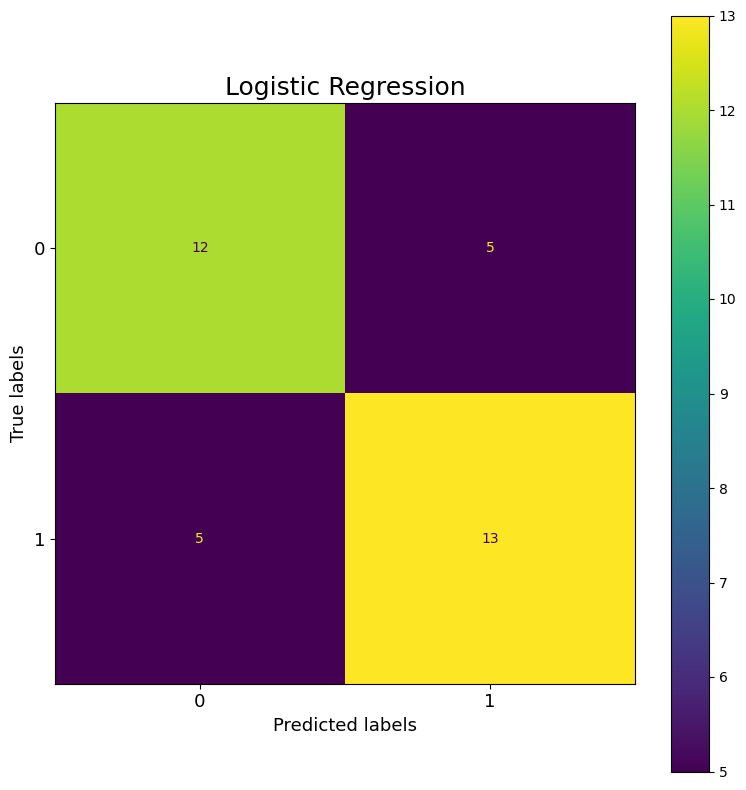

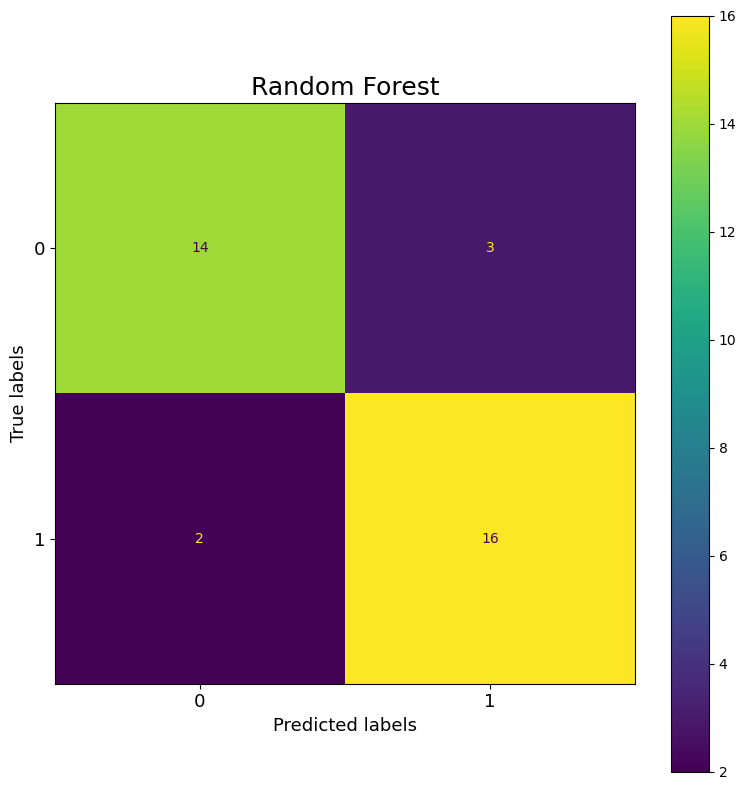

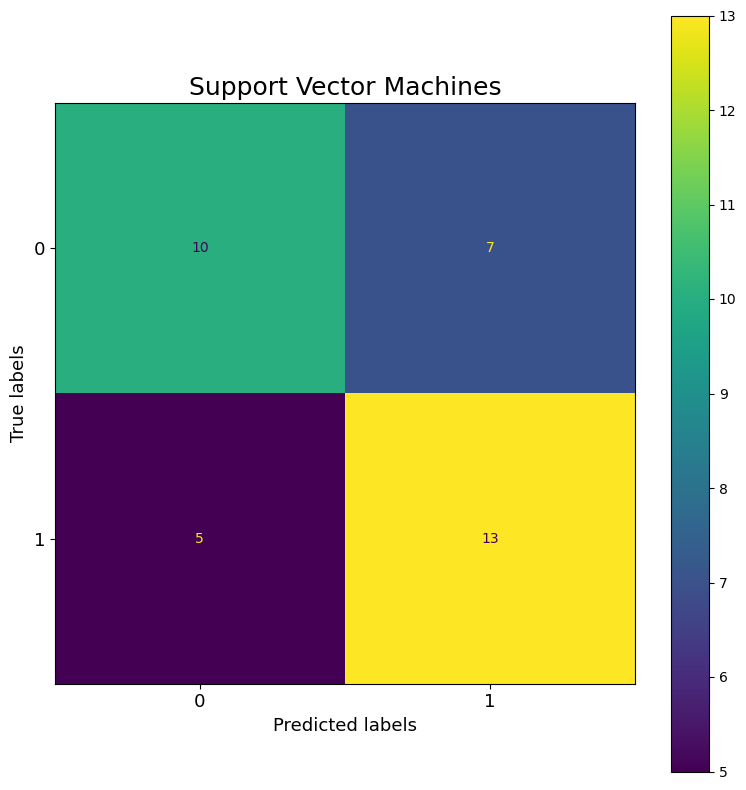

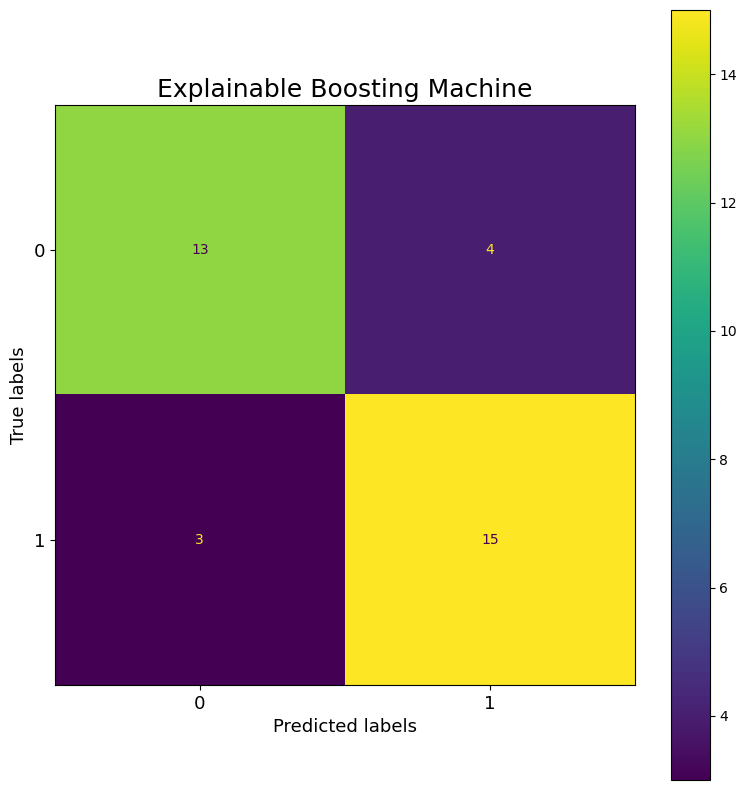

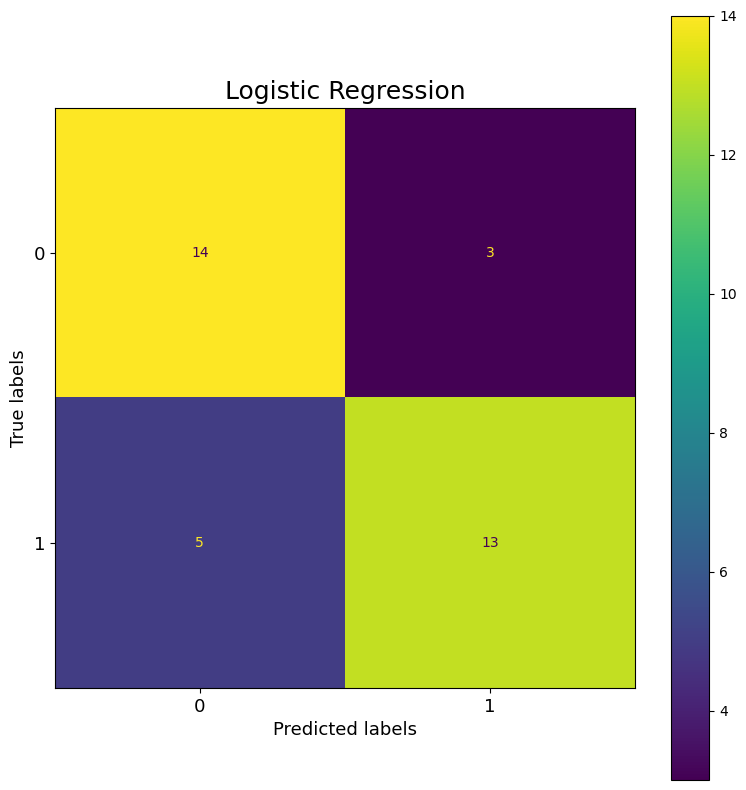

...

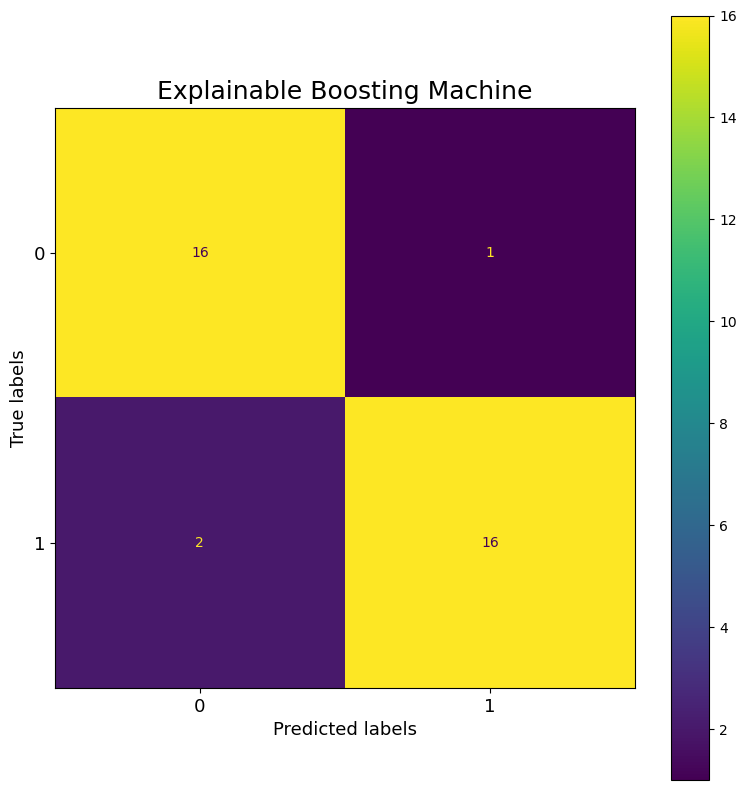

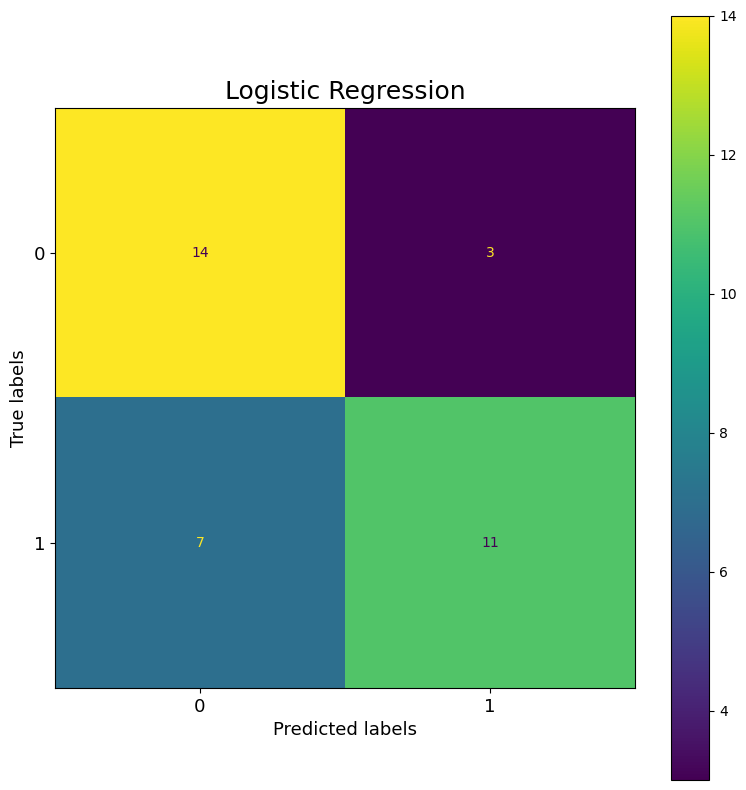

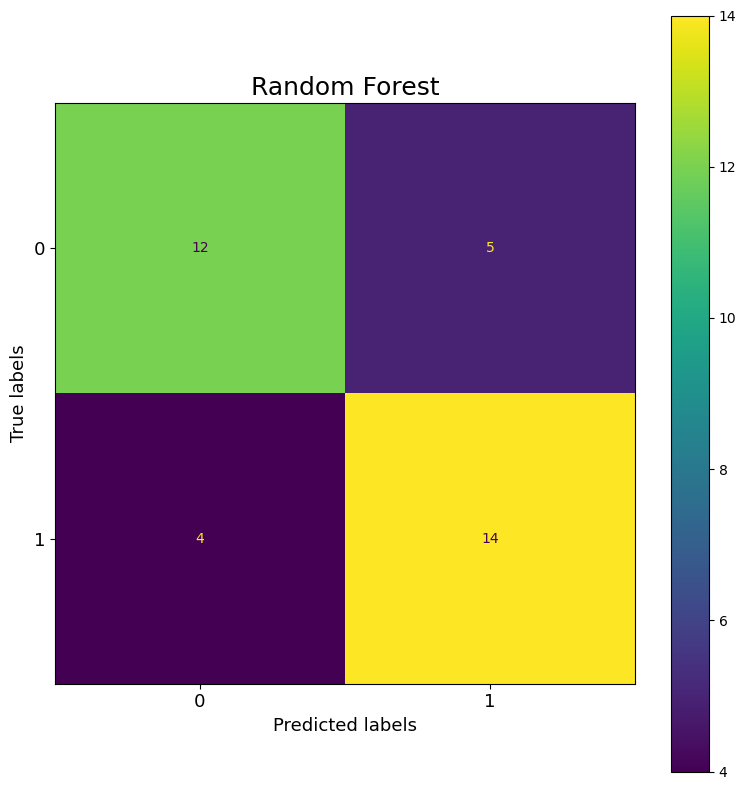

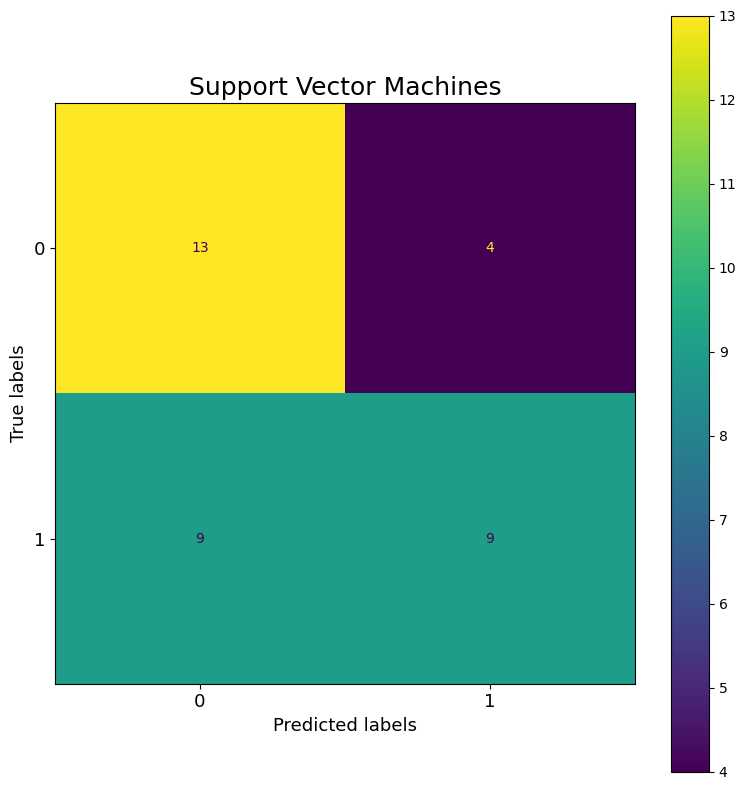

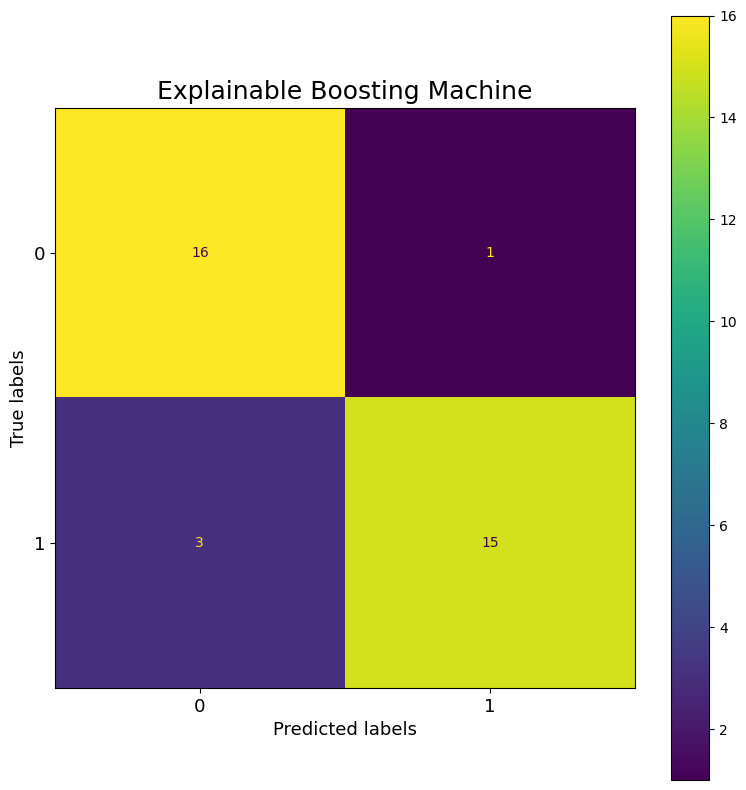

In [40]:
for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    visual.confusion_matrices_pred([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], 
                              [lr_ye, rf_ye, svm_ye, ebm_ye],
                              nrows=2, 
                              ncols=2, 
                              figsize=(8, 8),
                              title_size=title_size,
                              label_size=label_size,
                              titles=["Logistic Regression", "Random Forest", "Support Vector Machines", "Explainable Boosting Machine"],
                              save_name=f"{logs_dir}/darwin_conf_matrices_{i}"
                              )
    
    # plt.savefig(f"{logs_dir}/darwin_conf_matrices_95.png", bbox_inches="tight")
    
    plt.show()

## Curves

[[12  5]
 [ 5 13]]


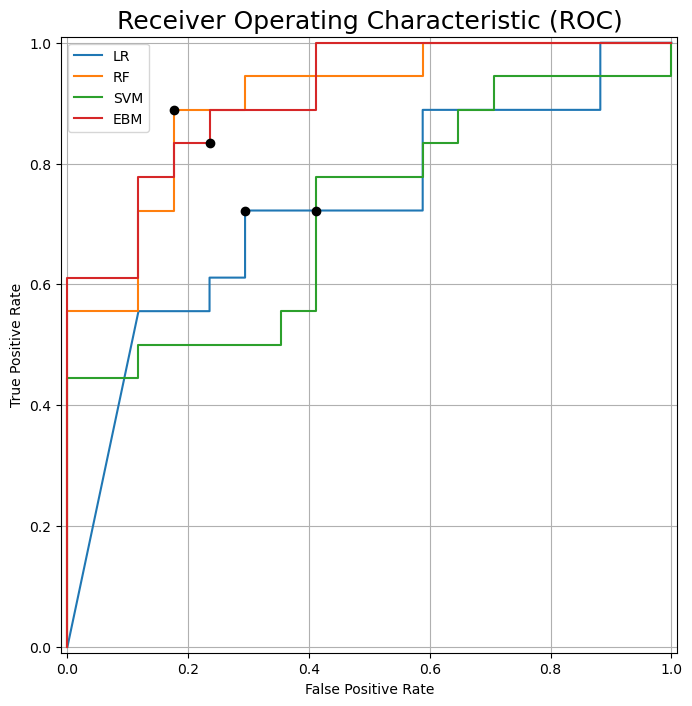

[[14  3]
 [ 5 13]]


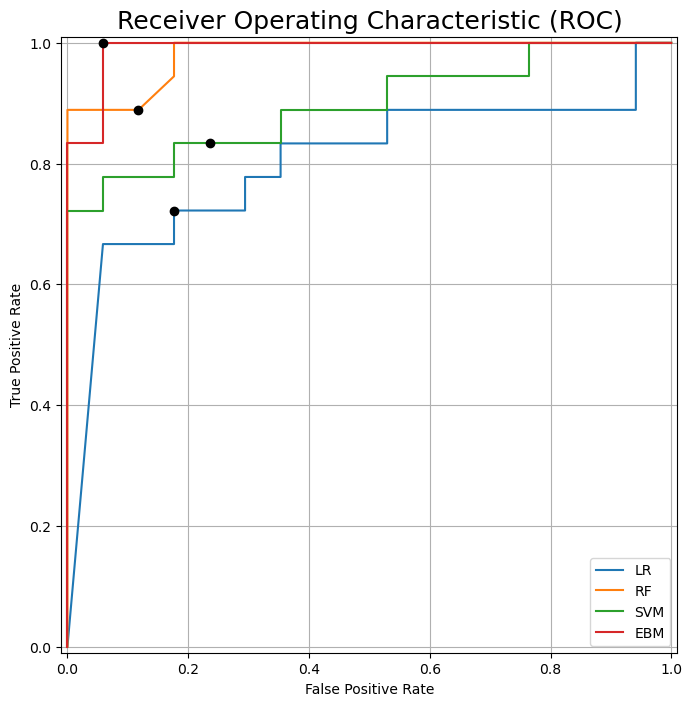

[[16  1]
 [ 2 16]]


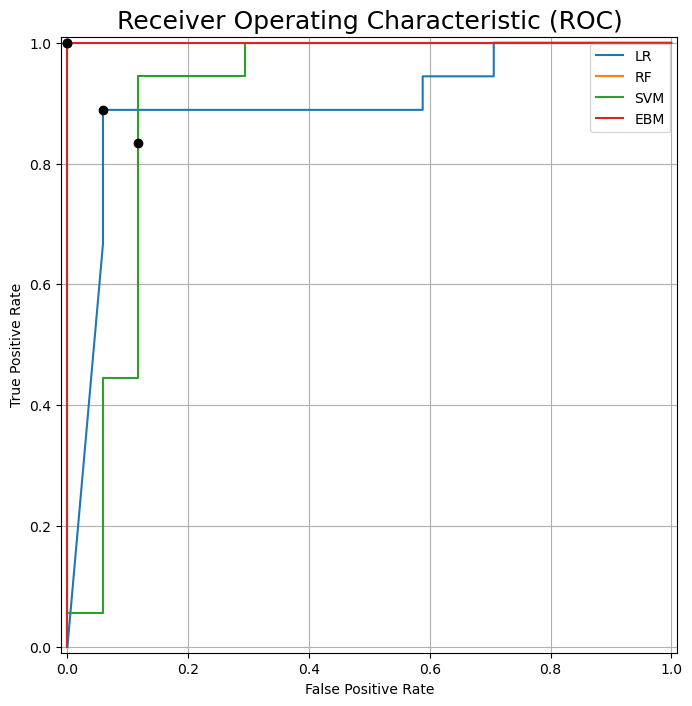

[[11  6]
 [ 3 15]]


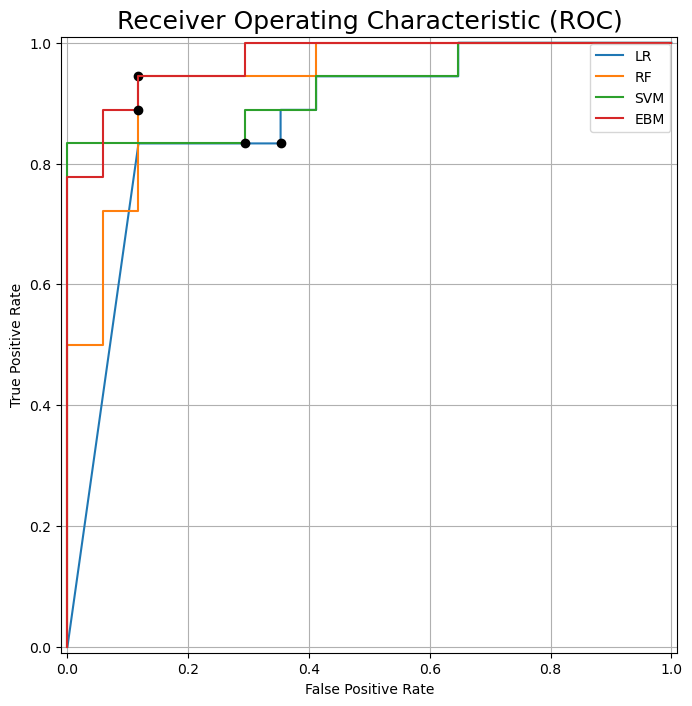

[[14  3]
 [ 2 16]]


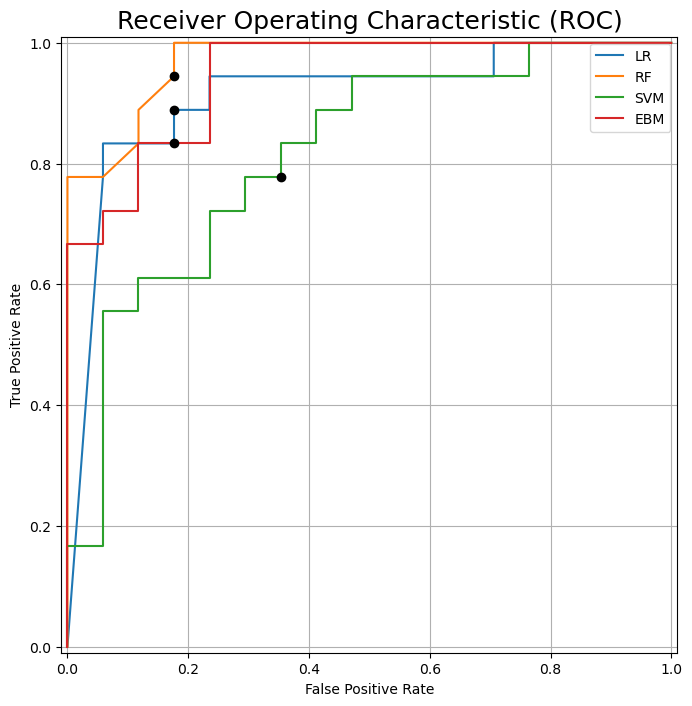

[[15  2]
 [ 6 12]]


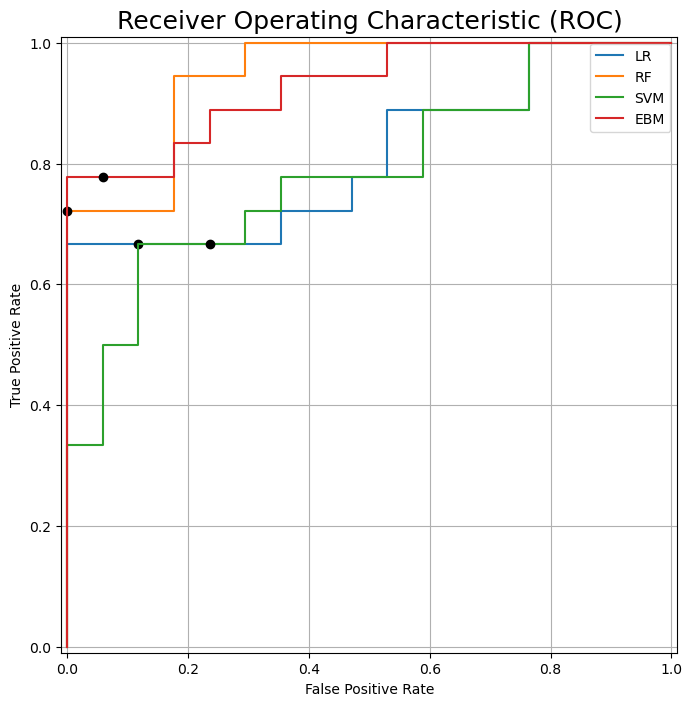

[[14  3]
 [ 3 15]]


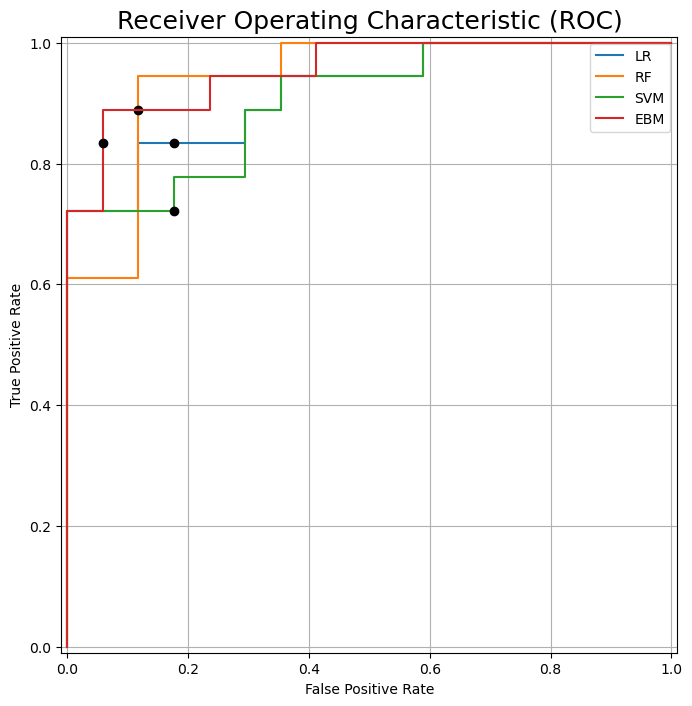

[[16  1]
 [ 7 11]]


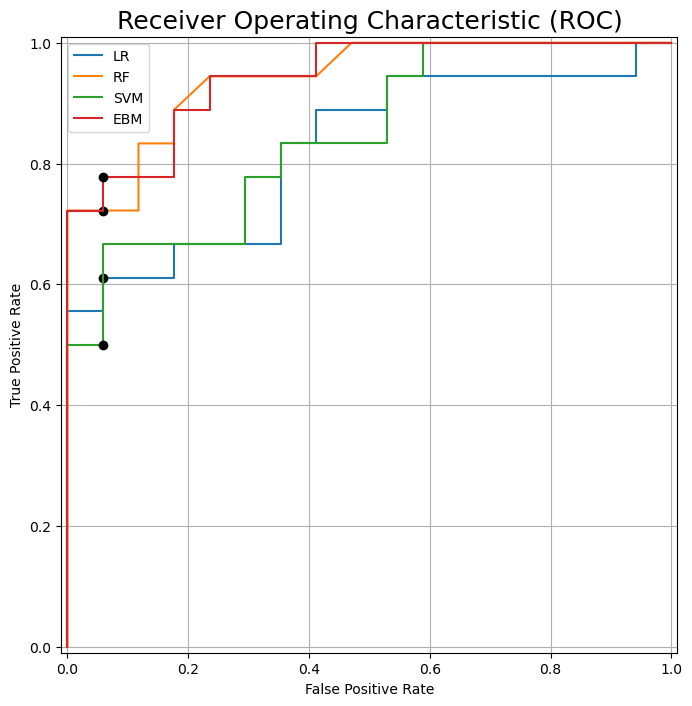

[[12  5]
 [ 2 16]]


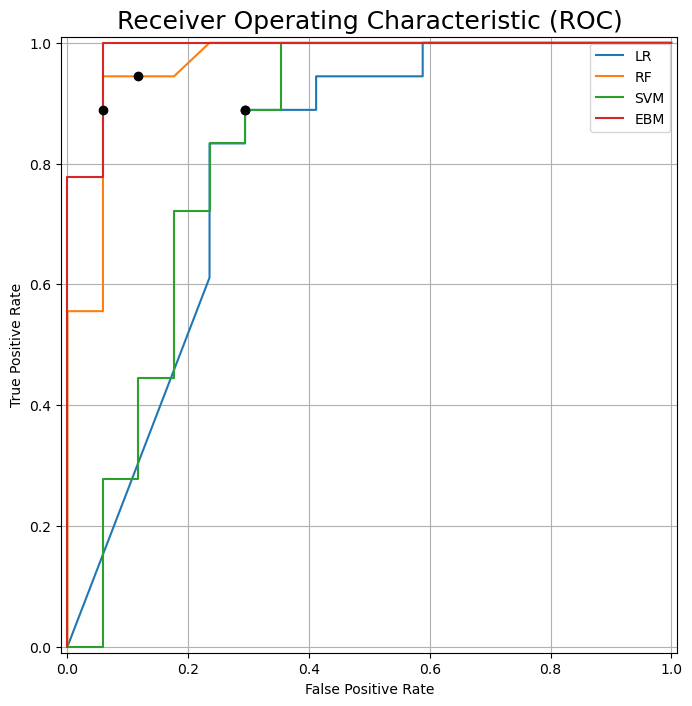

[[14  3]
 [ 7 11]]


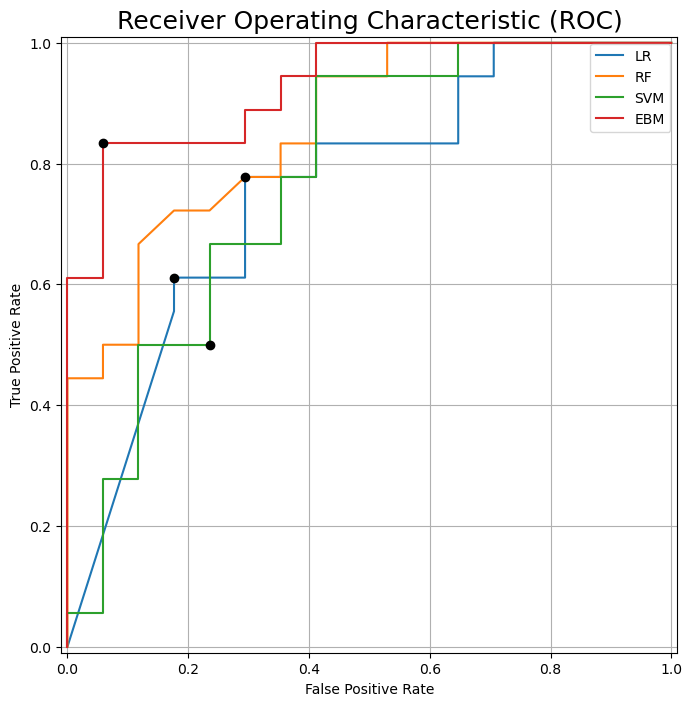

In [41]:
for i in range(sss_nsplits):
    plt.figure(figsize=(8, 8))
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    
    lr_cm = lr_cms[i]
    rf_cm = rf_cms[i]
    svm_cm = svm_cms[i]
    ebm_cm = ebm_cms[i]
    
    print(lr_cm)
    
    lr_y2d = lr_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    rf_y2d = rf_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    svm_y2d = svm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    ebm_y2d = ebm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    
    perf_analysis.compare_ROC([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
    
    plt.savefig(f"{logs_dir}/darwin_ROC_{i}.png", bbox_inches="tight")
    
    plt.show()

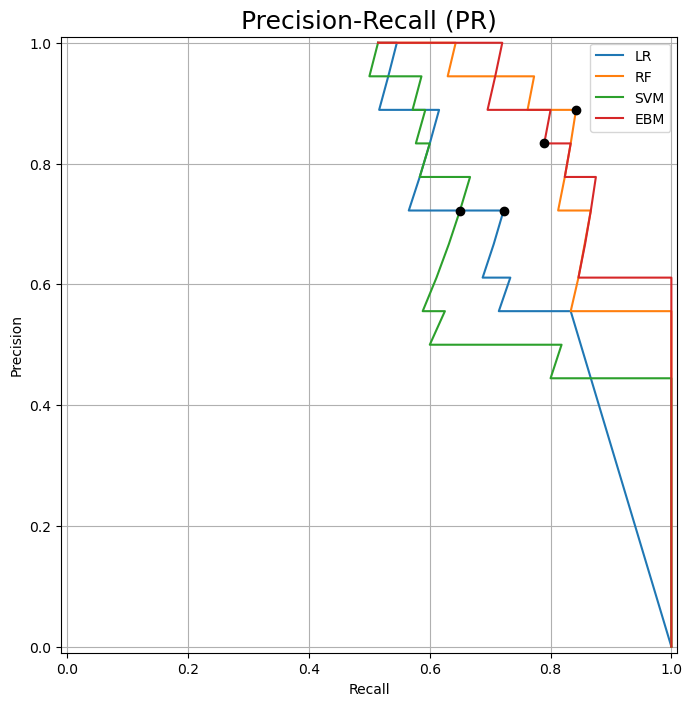

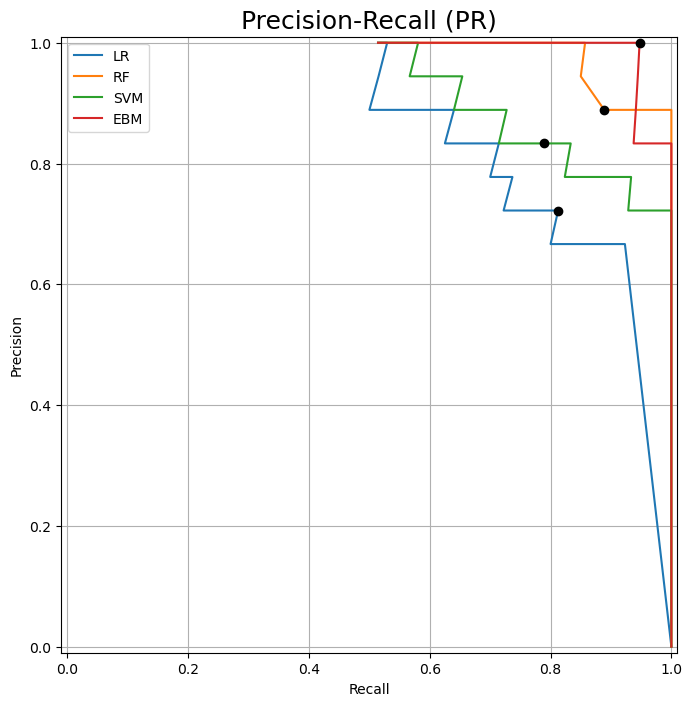

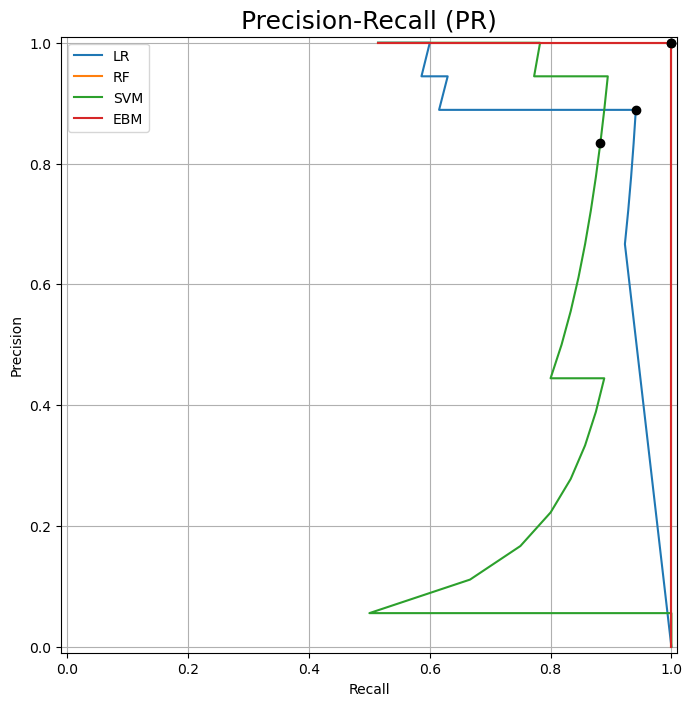

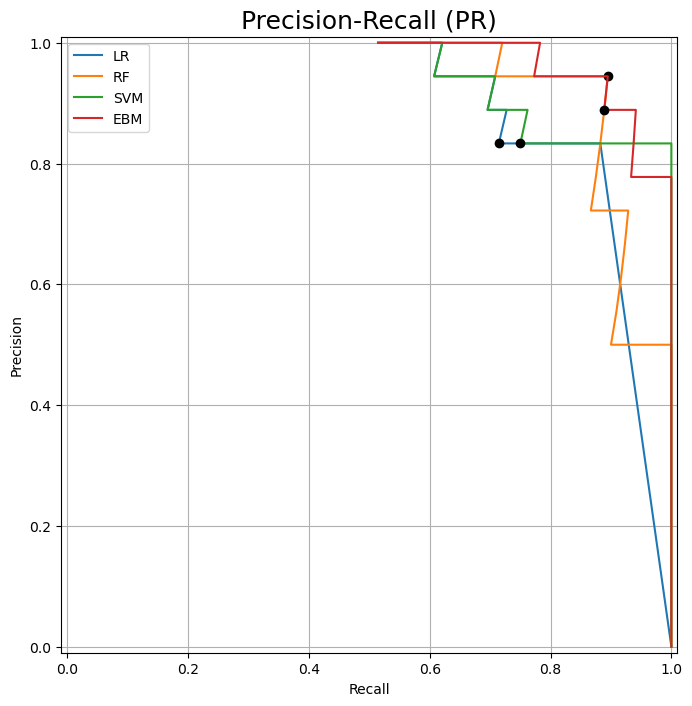

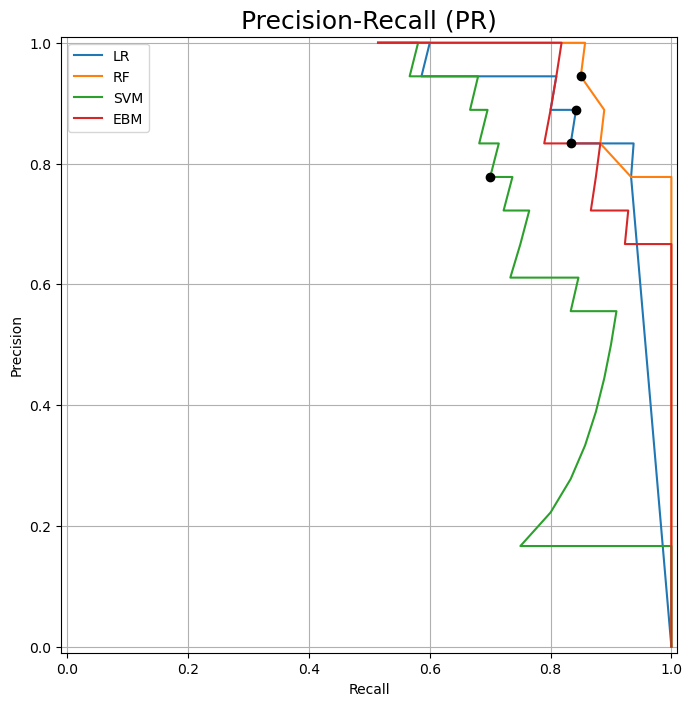

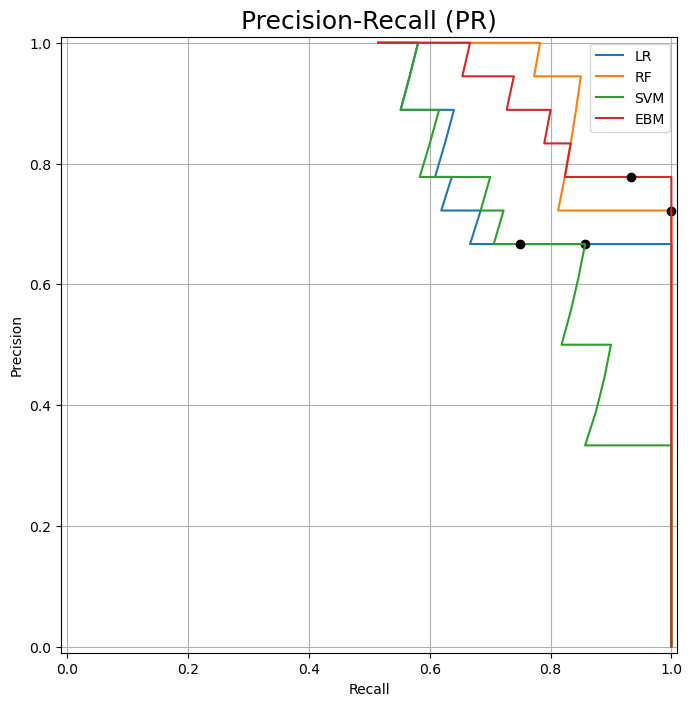

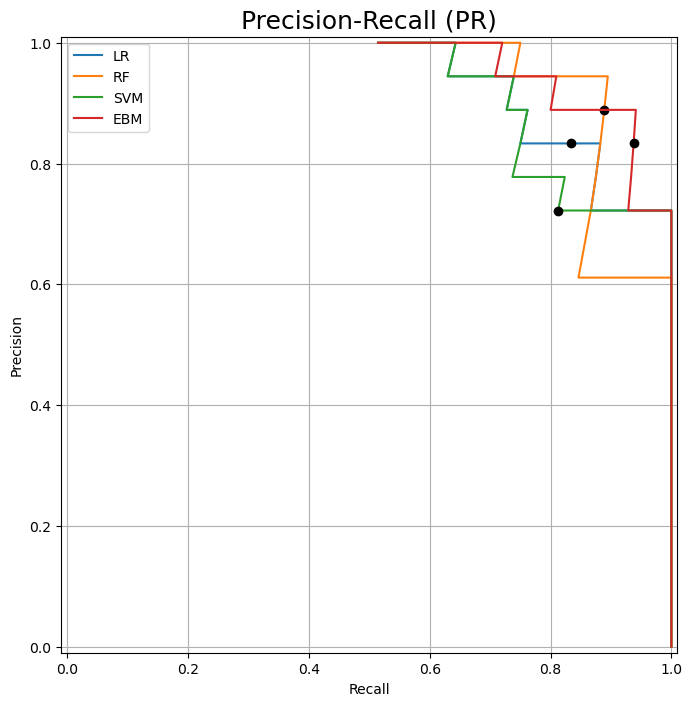

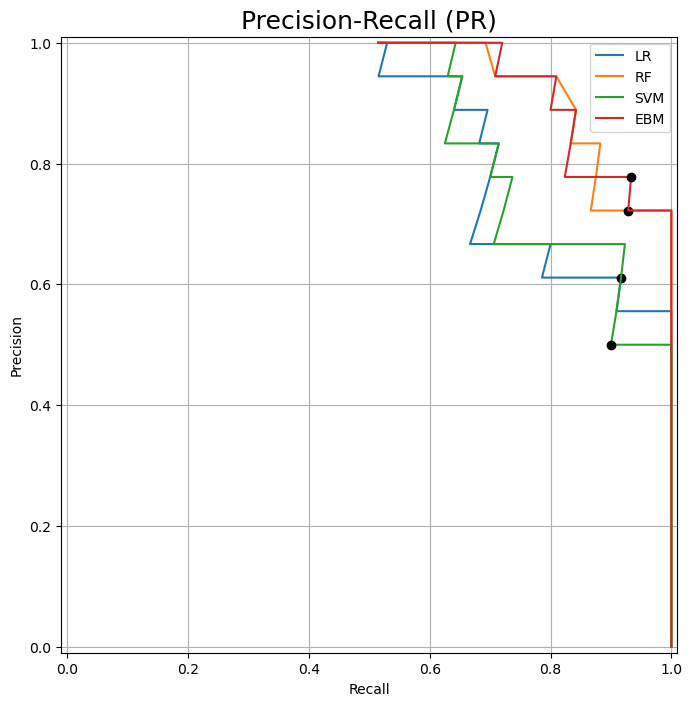

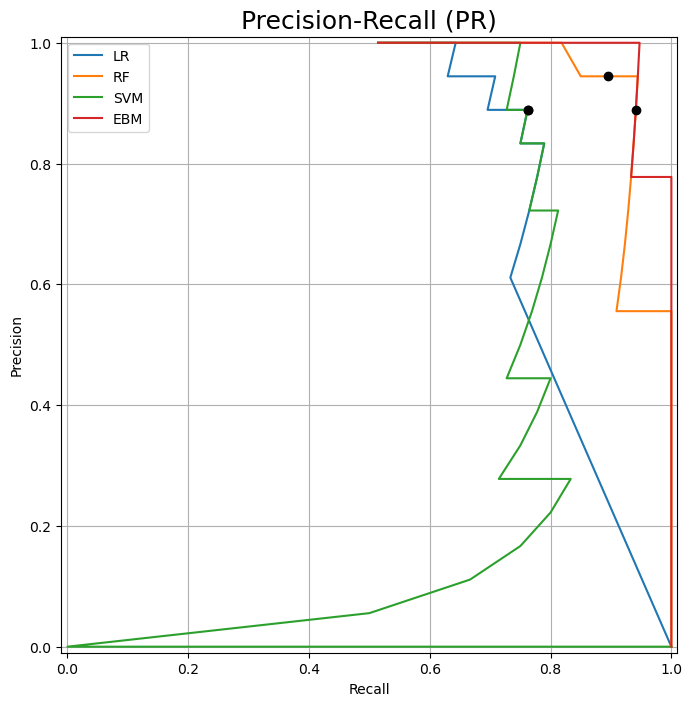

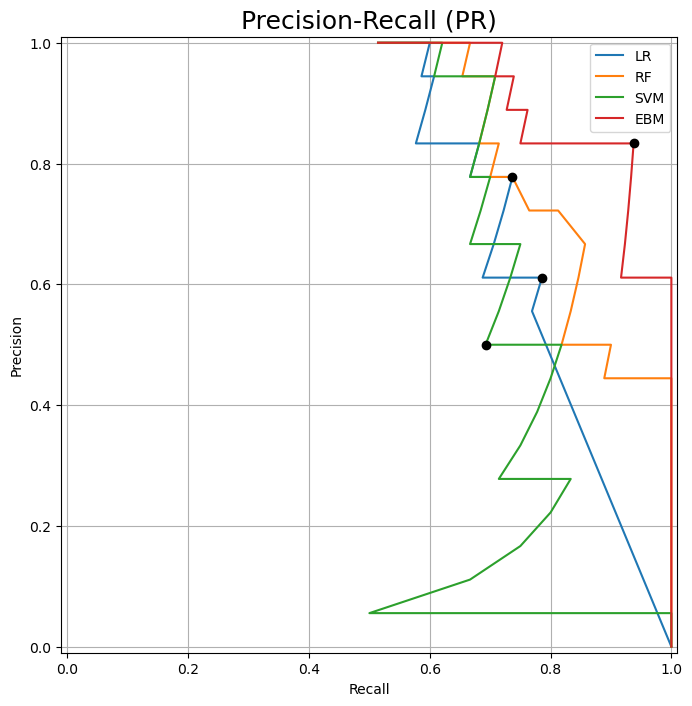

In [42]:
for i in range(sss_nsplits):
    plt.figure(figsize=(8, 8))
    
    lr_cm = lr_cms[i]
    rf_cm = rf_cms[i]
    svm_cm = svm_cms[i]
    ebm_cm = ebm_cms[i]
    
    lr_y2d = lr_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    rf_y2d = rf_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    svm_y2d = svm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    ebm_y2d = ebm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    
    perf_analysis.compare_PR([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
    
    plt.savefig(f"{logs_dir}/darwin_PR_{i}.png", bbox_inches="tight")
    
    plt.show()

## Local Explanations

### LIME

In [43]:
for i in range(sss_nsplits):
    lr_LIME_explanation = lr_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], lr_clfs[i].predict_proba)
    lr_LIME_explanation.show_in_notebook(show_table=True)
    lr_LIME_explanation.save_to_file(f"{logs_dir}/darwin_LR_LIME_{i}.html")

In [44]:
for i in range(sss_nsplits):
    rf_LIME_explanation = rf_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], rf_clfs[i].predict_proba)
    rf_LIME_explanation.show_in_notebook(show_table=True)
    rf_LIME_explanation.save_to_file(f"{logs_dir}/darwin_RF_LIME_{i}.html")

In [45]:
for i in range(sss_nsplits):
    svm_LIME_explanation = svm_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], svm_clfs[i].predict_proba)
    svm_LIME_explanation.show_in_notebook(show_table=True)
    svm_LIME_explanation.save_to_file(f"{logs_dir}/darwin_SVM_LIME_{i}.html")

### SHAP & EBM

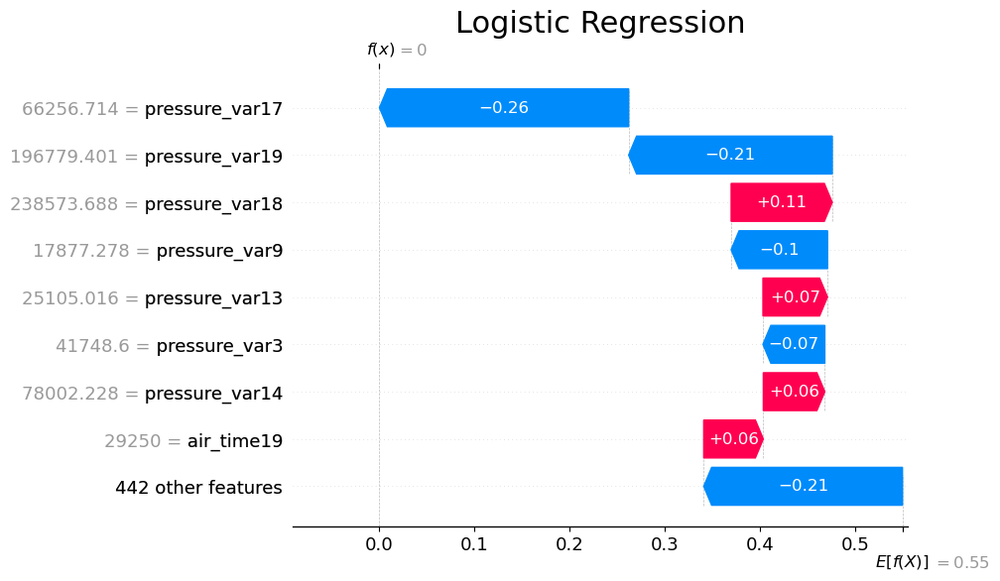

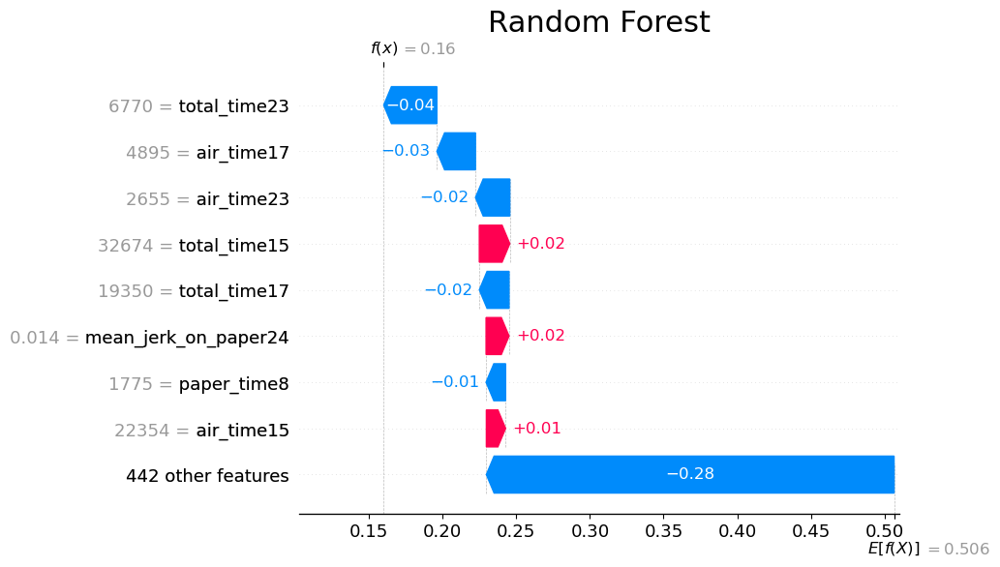

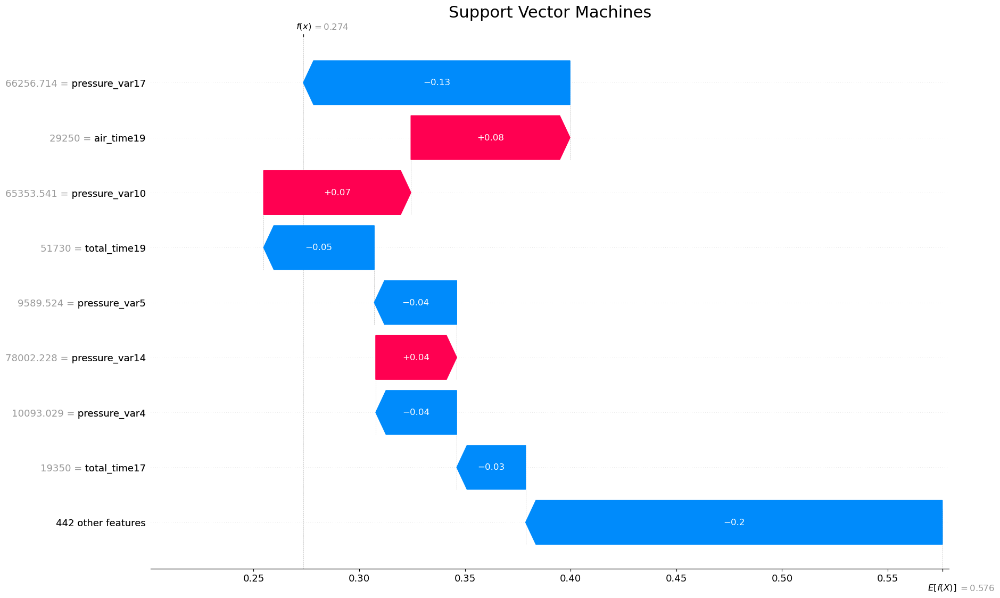

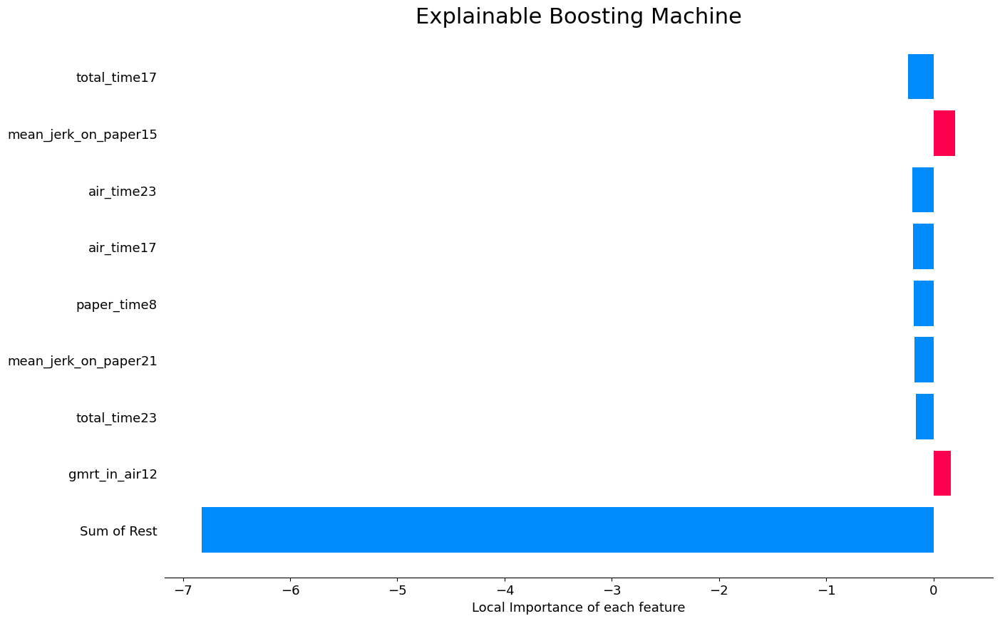

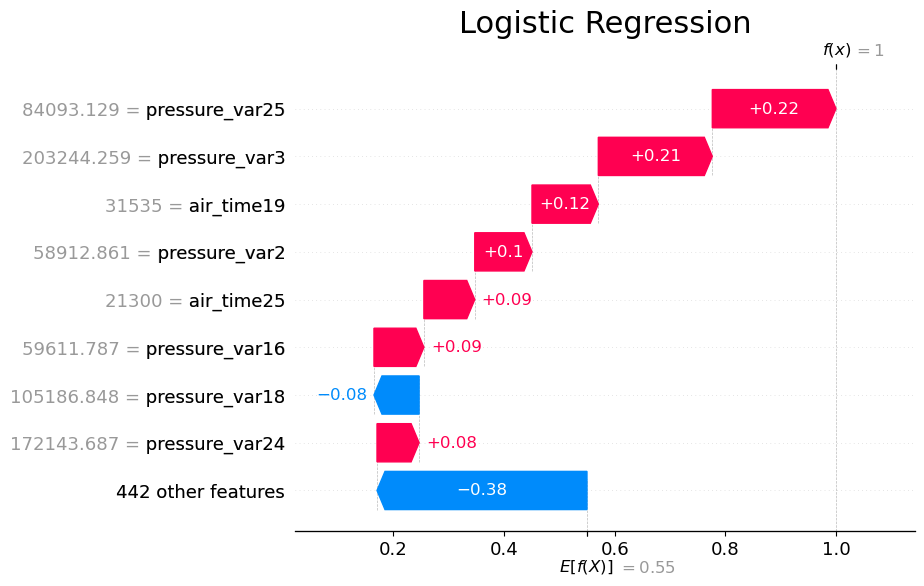

...

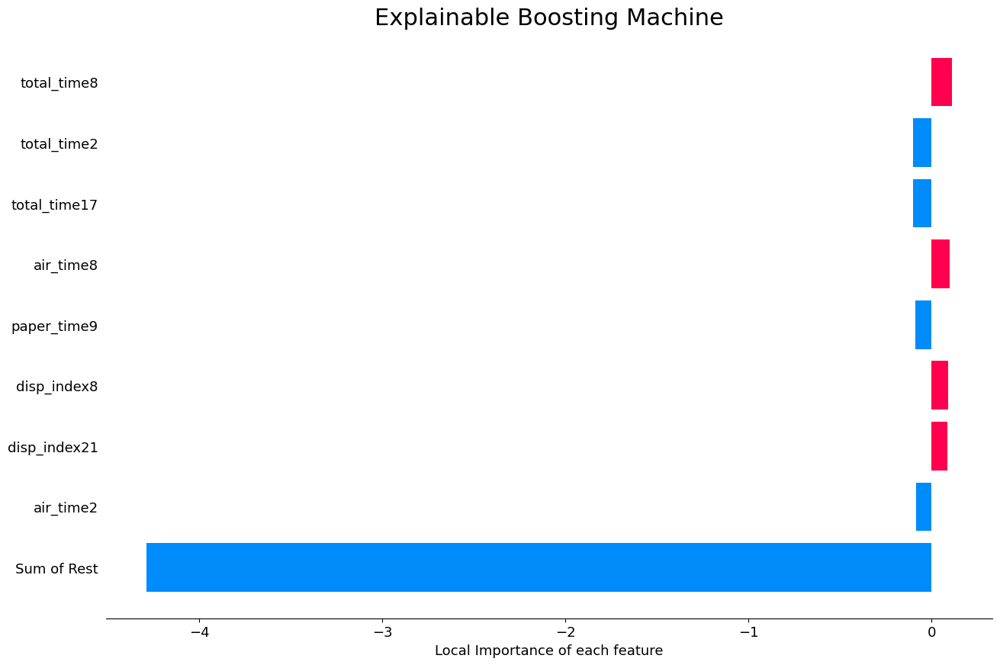

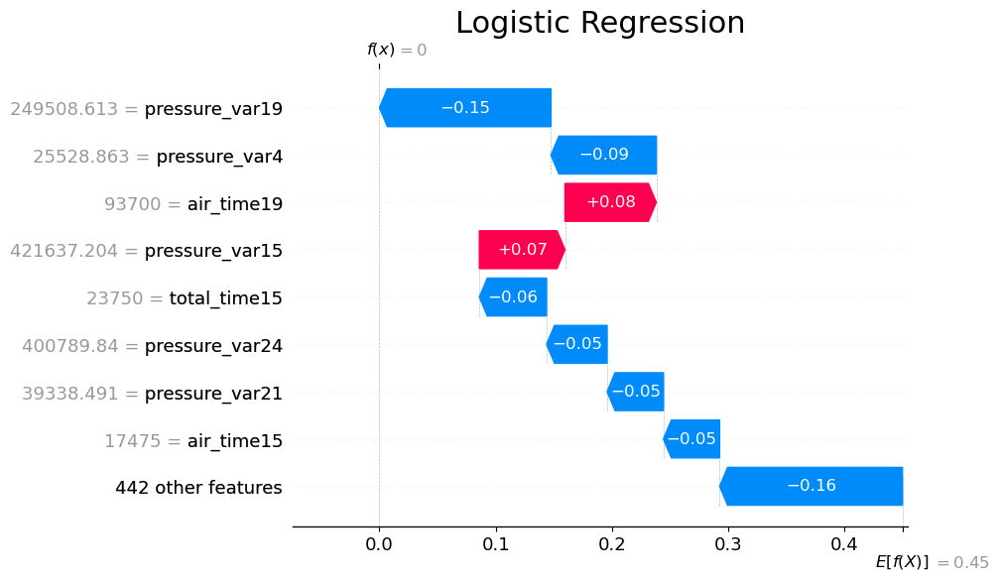

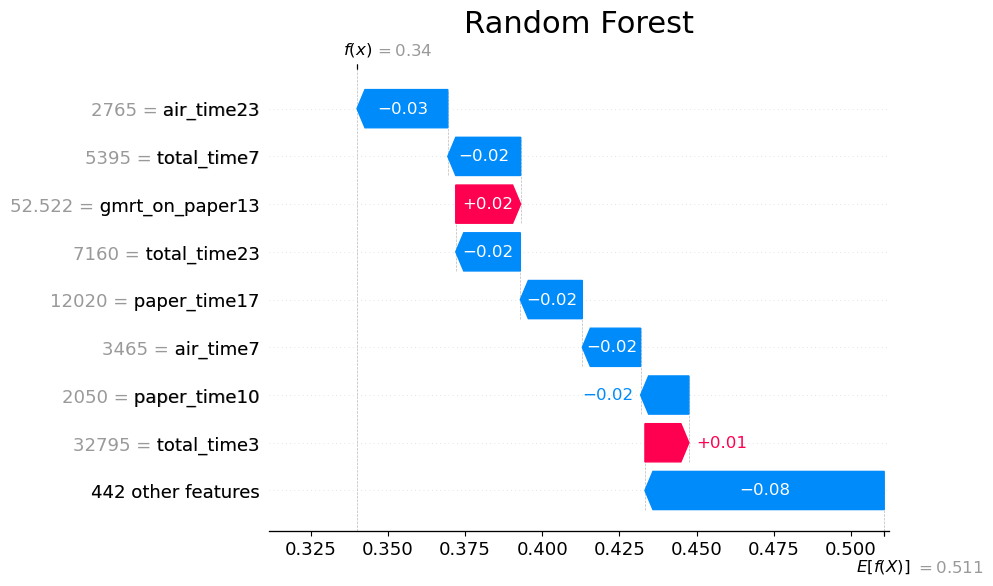

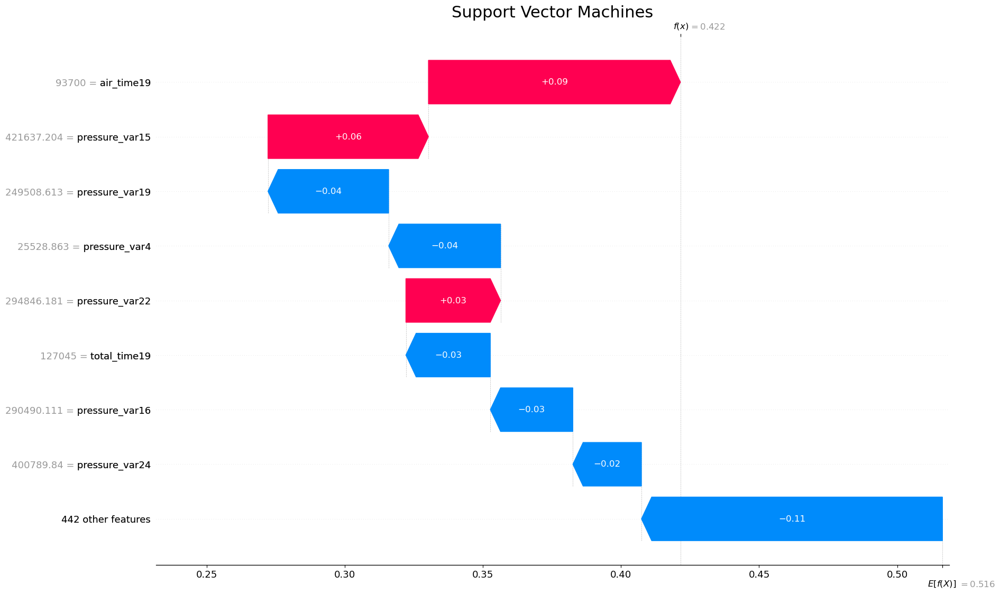

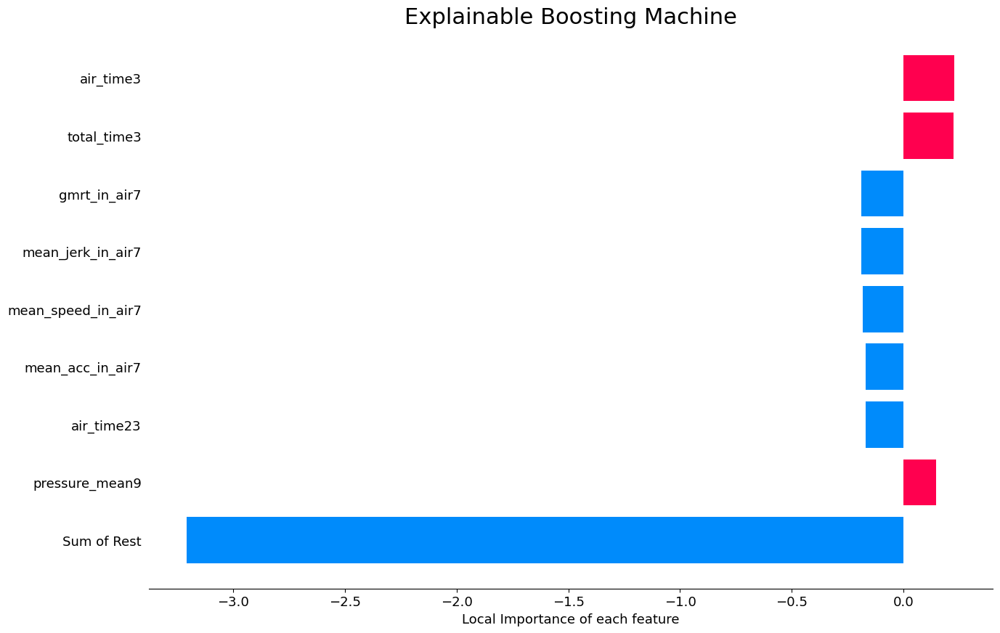

In [46]:
for i in range(sss_nsplits):
    Exp_inst_pd = X_tests_pd[i].iloc[Exp_index]
    
    lr_shap_loc_values = np.array(lr_shaps[i].shap_values(Exp_inst_pd))
    rf_shap_loc_values = np.array(rf_shaps[i].shap_values(Exp_inst_pd))
    svm_shap_loc_values = np.array(svm_shaps[i].shap_values(Exp_inst_pd))
    
    explanations = [shap.Explanation(lr_shap_loc_values[1, :], lr_shaps[i].expected_value[1], data=Exp_inst_pd),
                shap.Explanation(rf_shap_loc_values[1, :], rf_shaps[i].expected_value[1], data=Exp_inst_pd),
                shap.Explanation(svm_shap_loc_values[1, :], svm_shaps[i].expected_value[1], data=Exp_inst_pd)]
    
    ebm_local = ebm_clfs[i].explain_local(X_tests_pd[i], Y_tests[i])
    
    visual.local_shap(explanations, 
                      ebm_local.data(key=Exp_index),
                      nrows = 2,
                      ncols = 2,
                      figsize = (15,10),
                      title_size = 22,
                      label_size = label_size,
                      titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                      ebm_colors = shap_colors / 255,
                      num_features=9,
                      save_name=f"{logs_dir}/darwin_local_SHAP_EBM_{i}")
    
    plt.show()


## Global Explanations

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

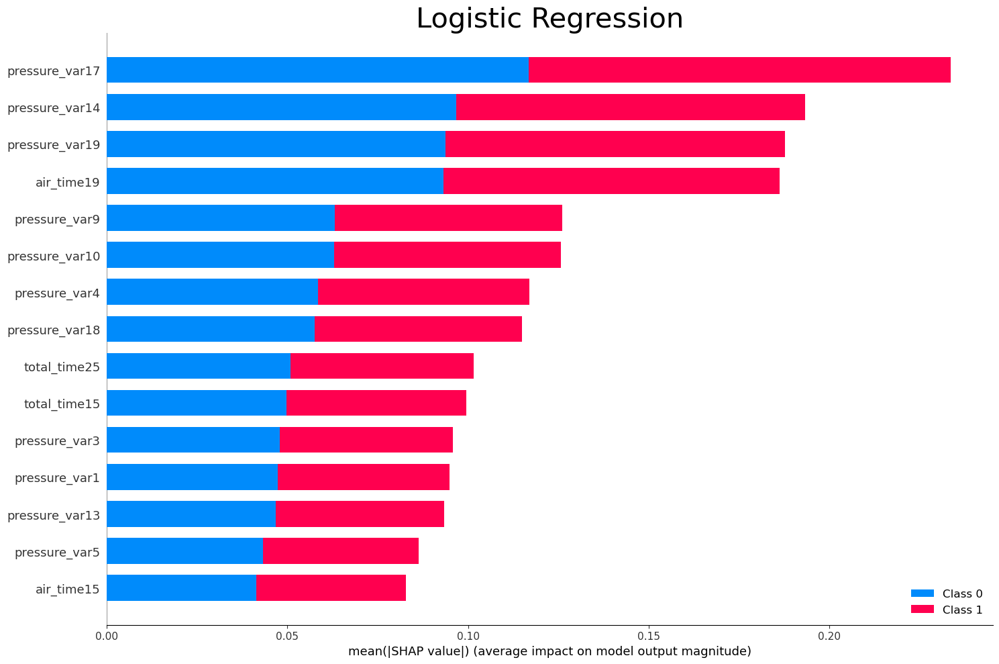

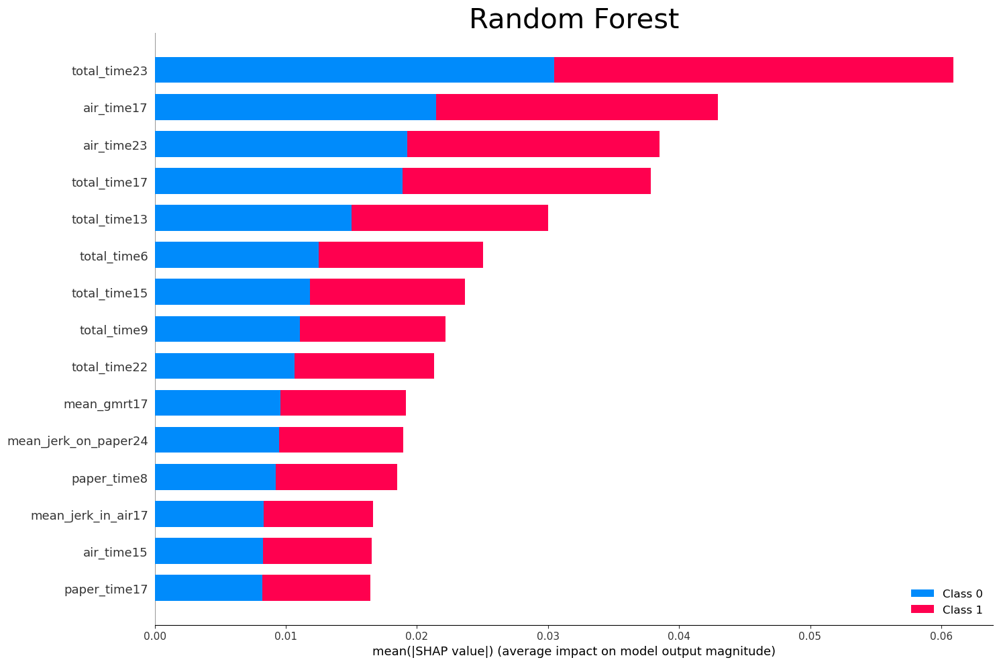

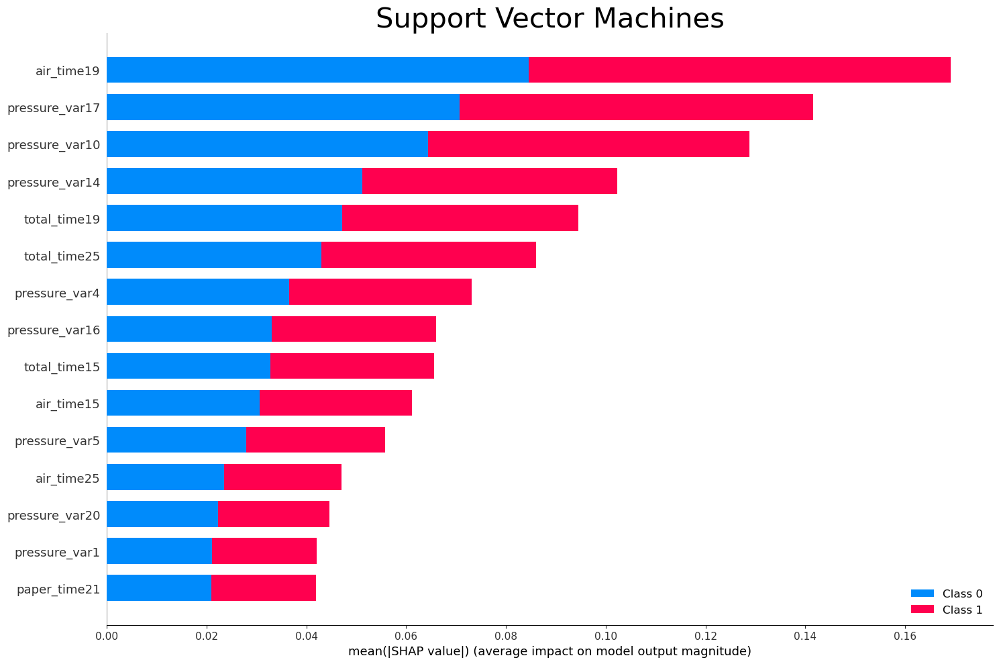

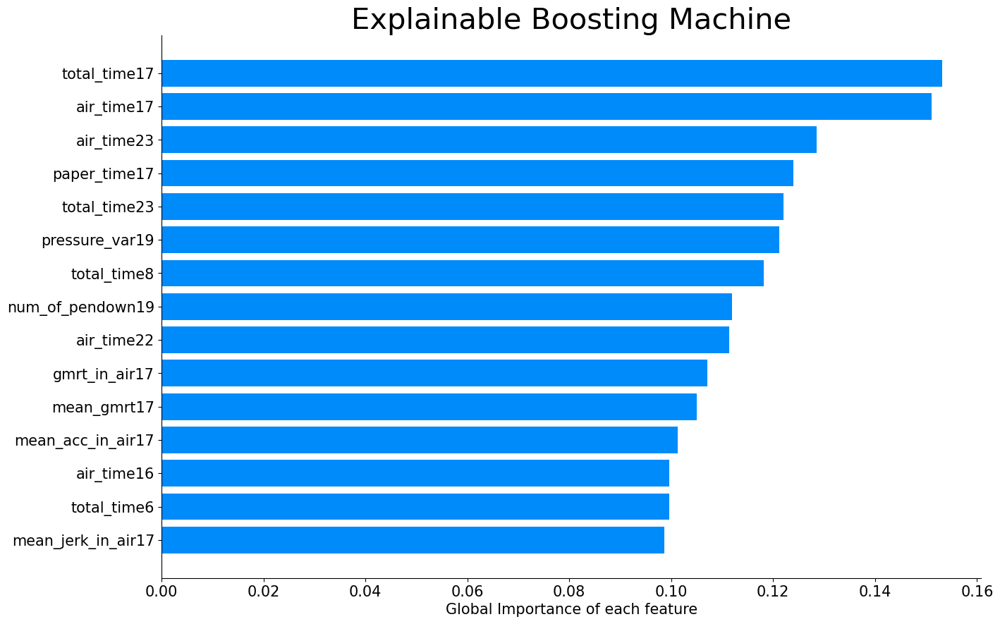

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

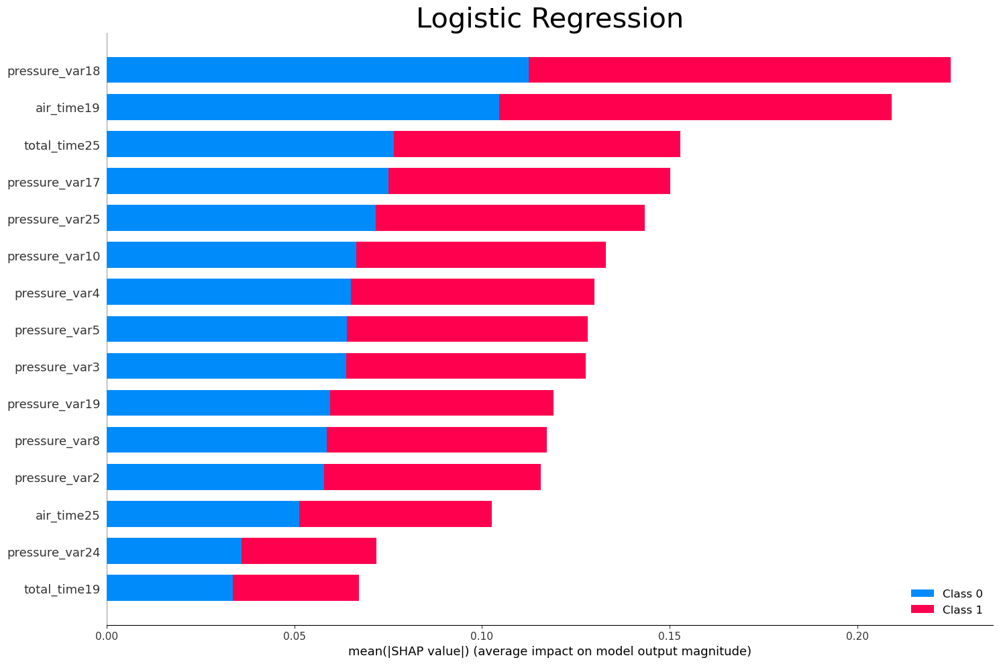

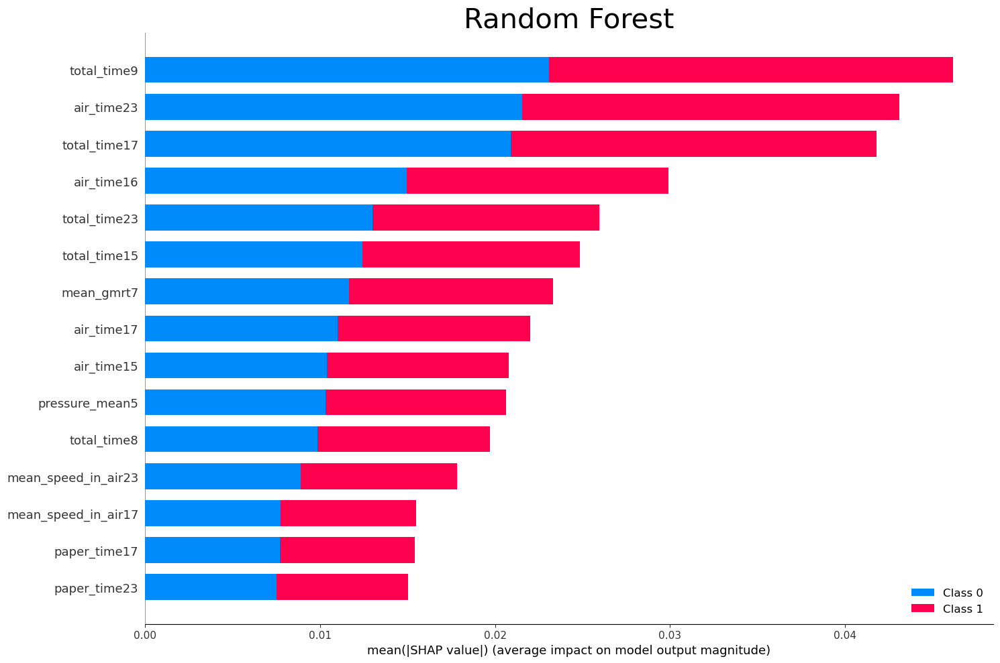

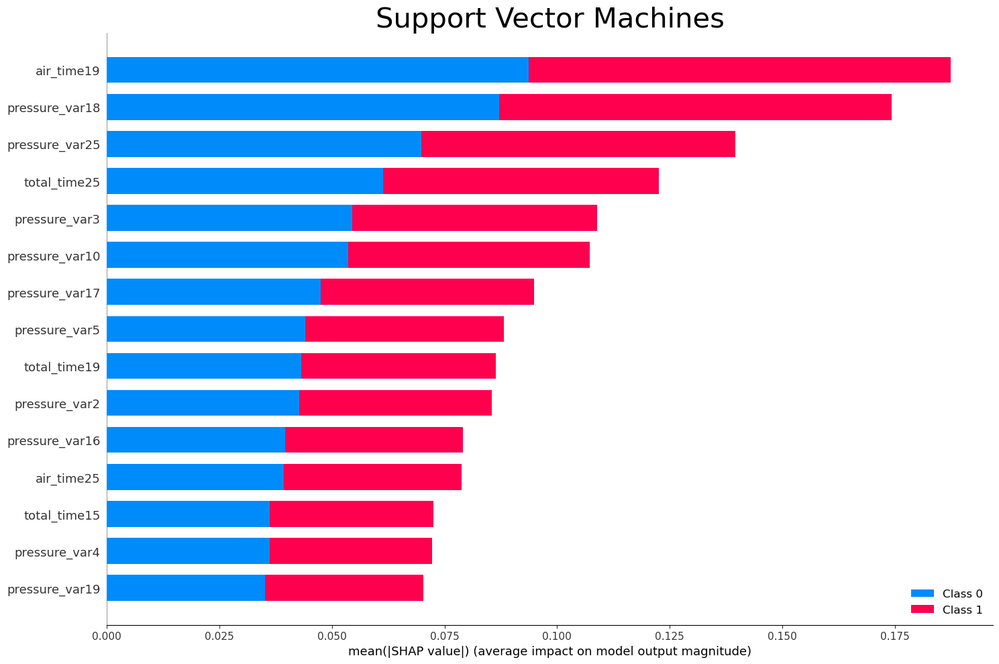

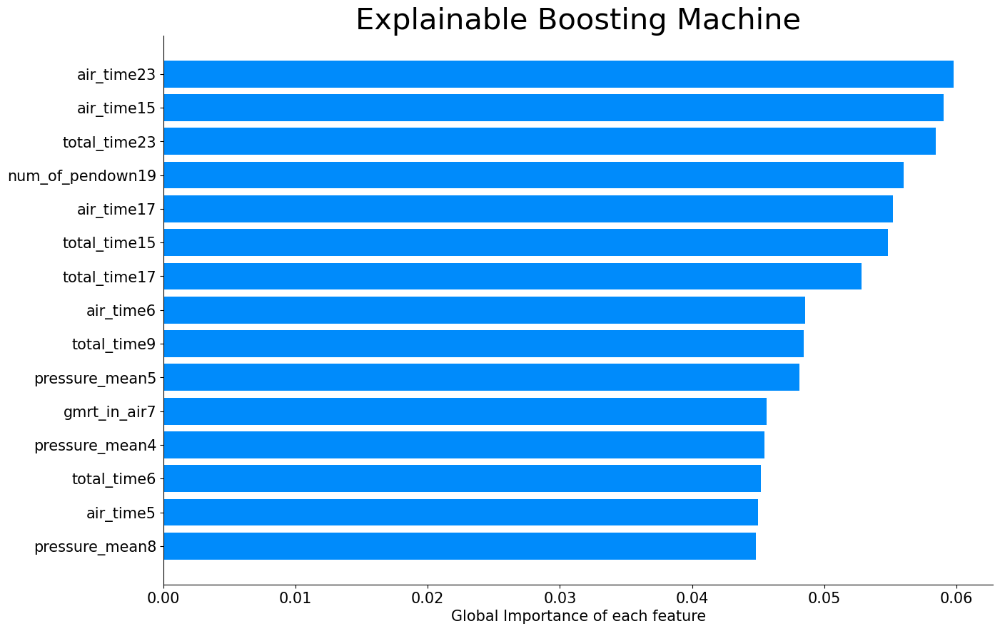

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

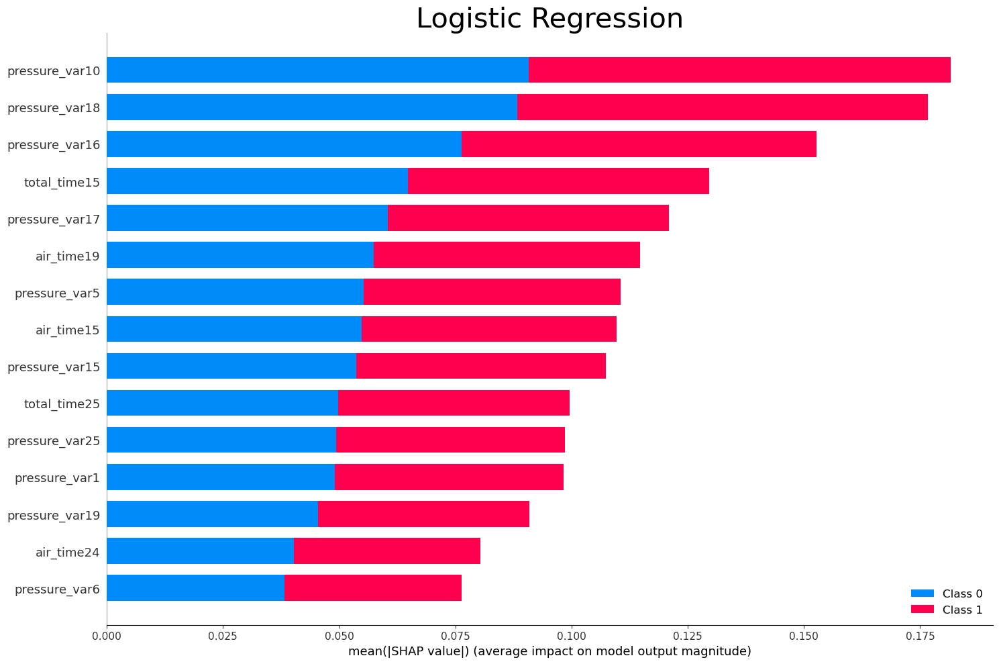

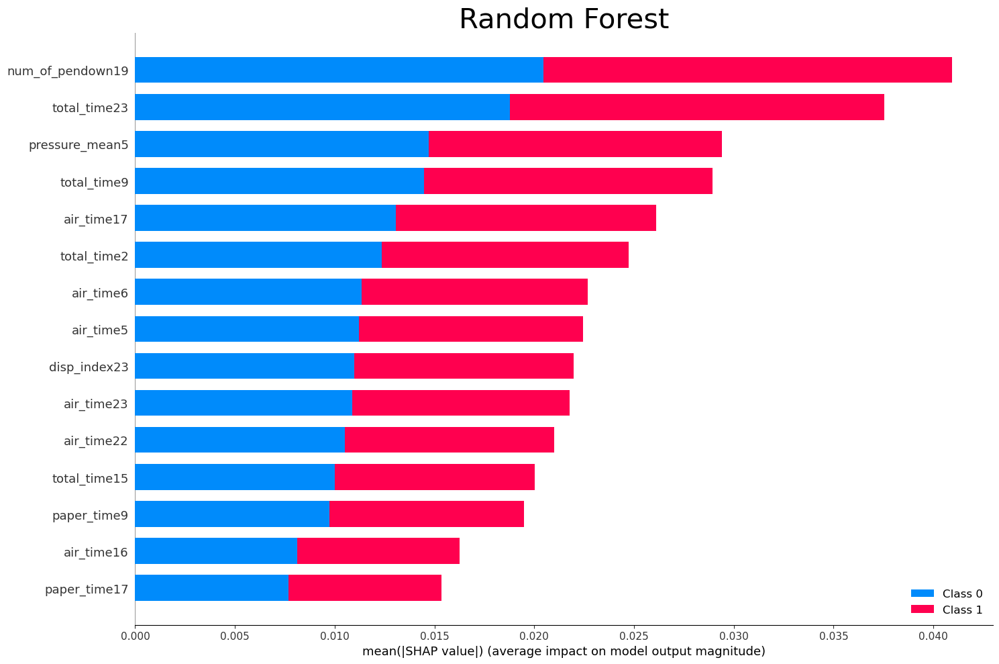

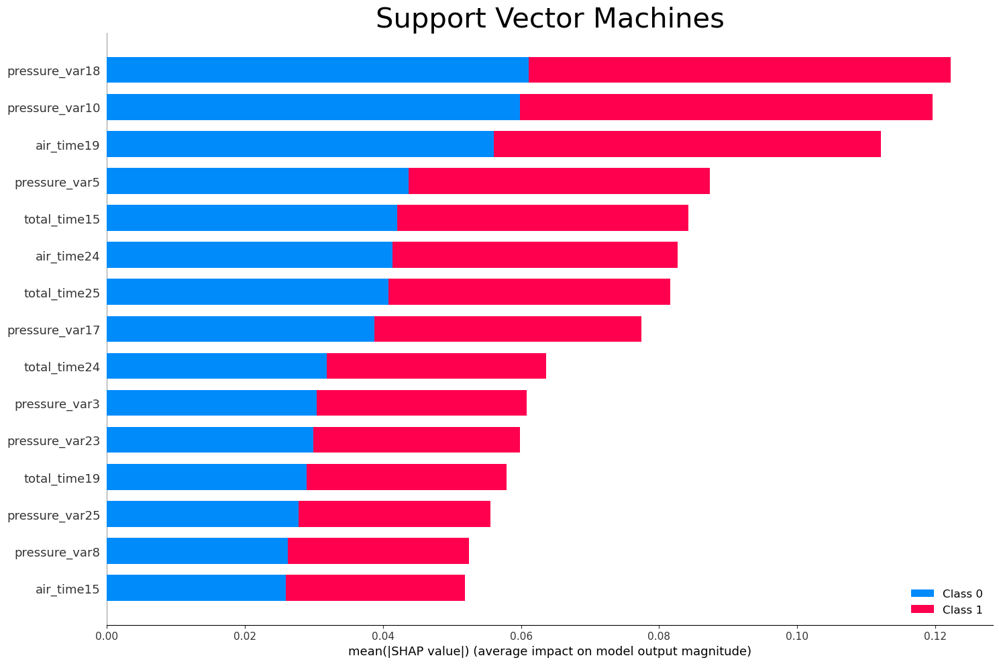

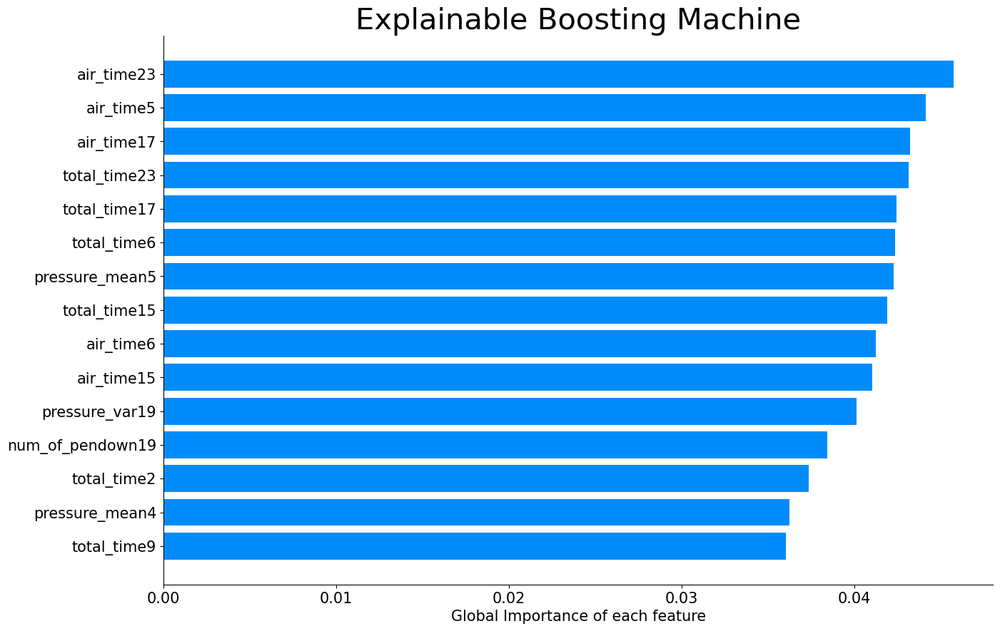

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

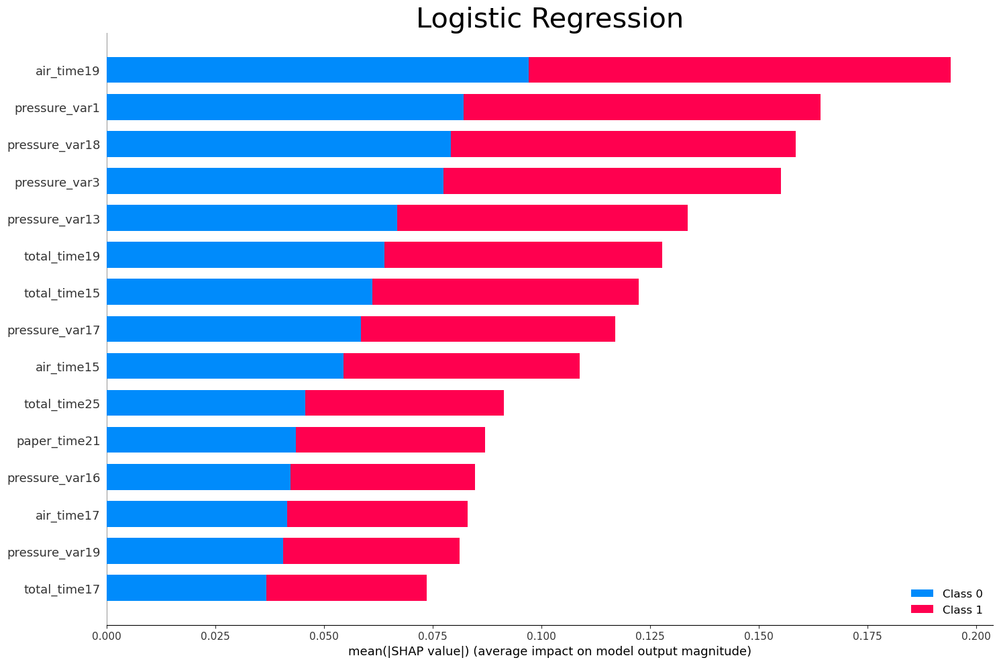

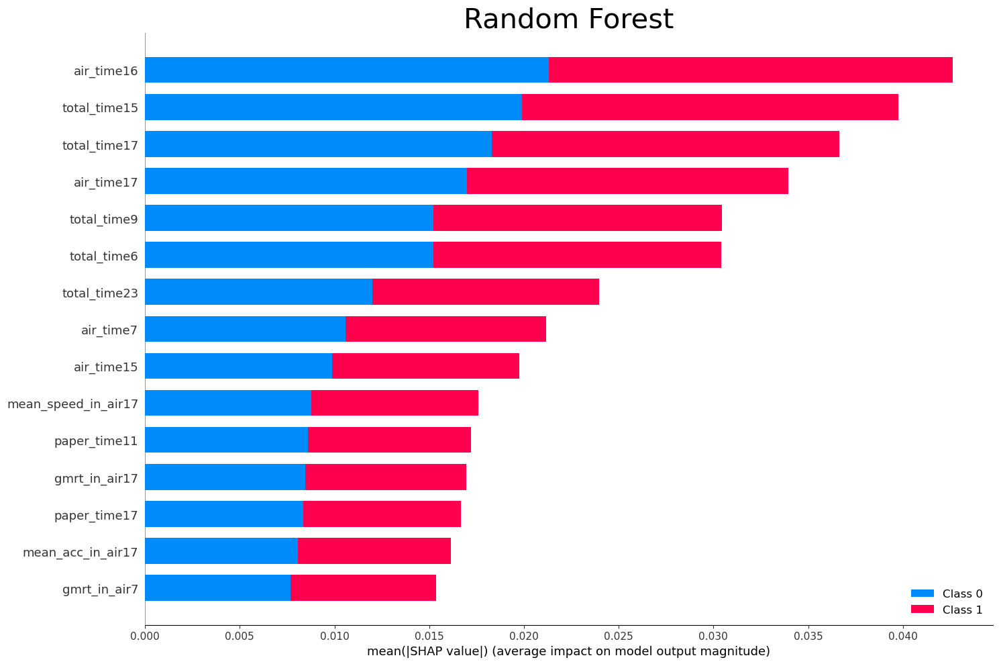

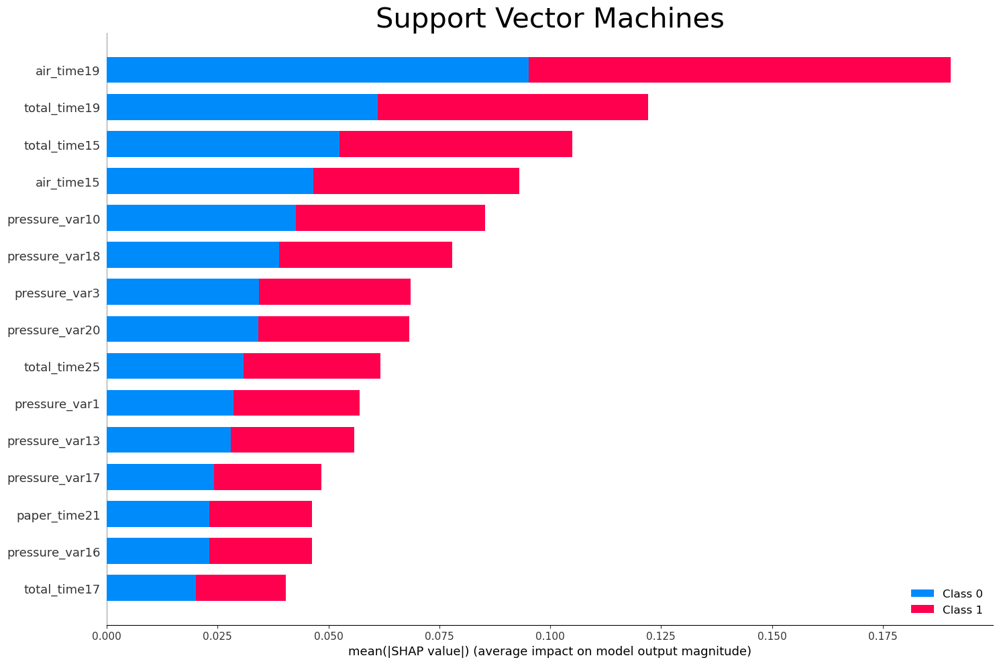

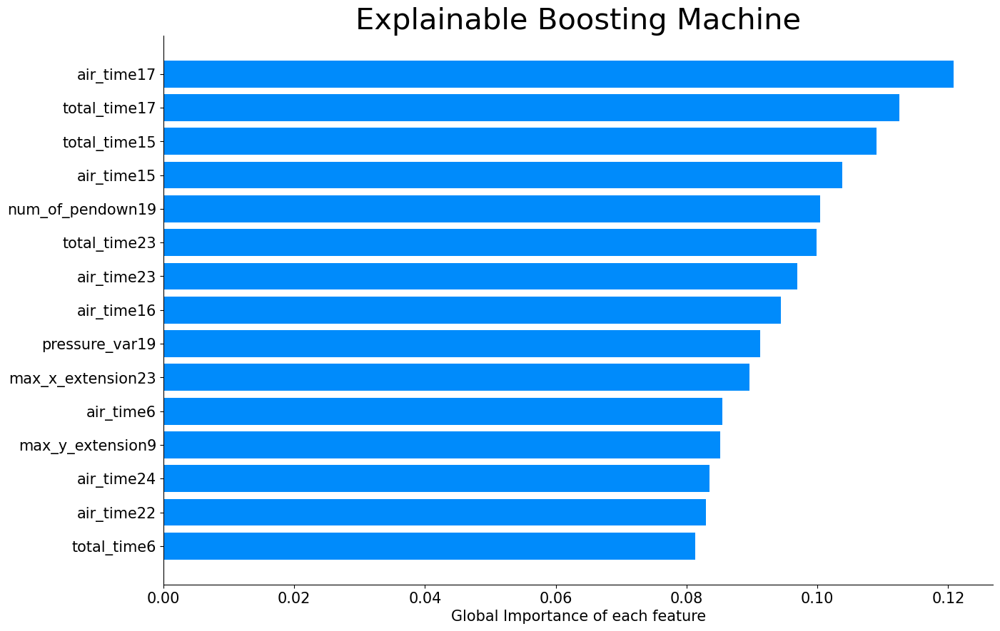

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

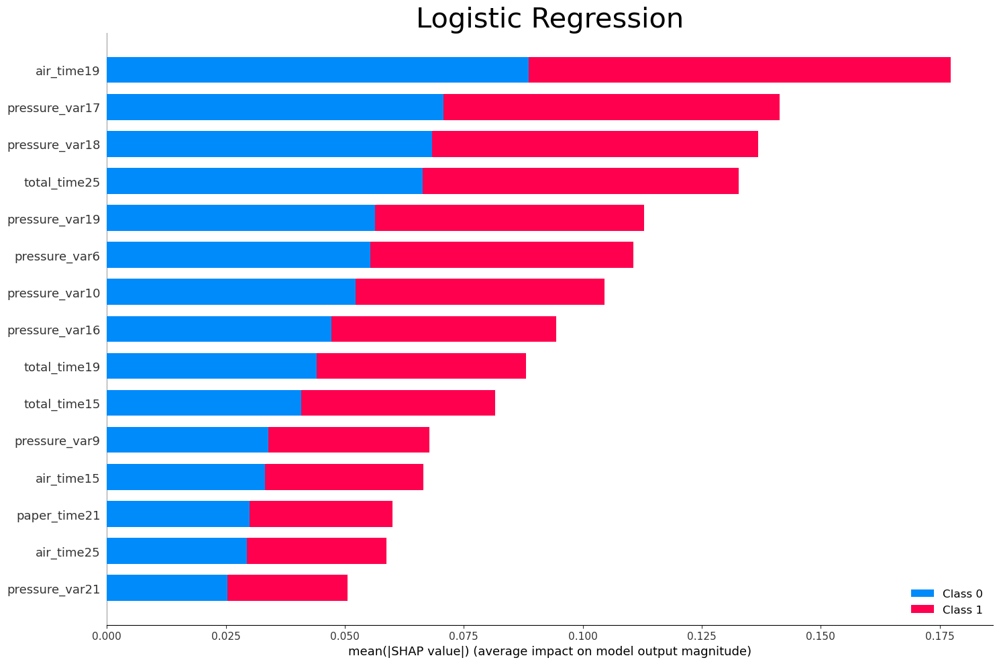

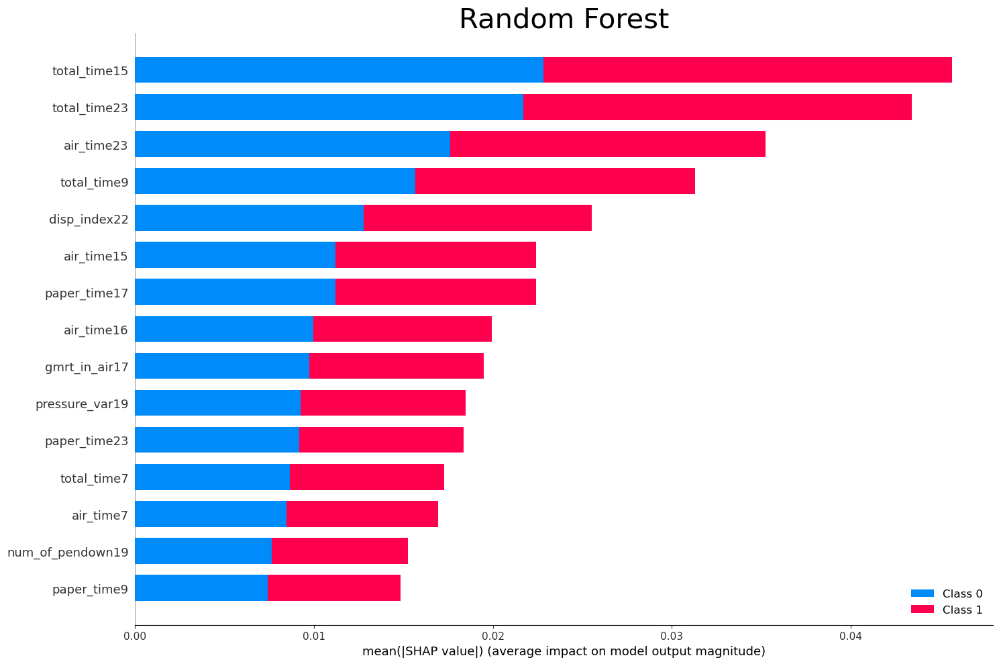

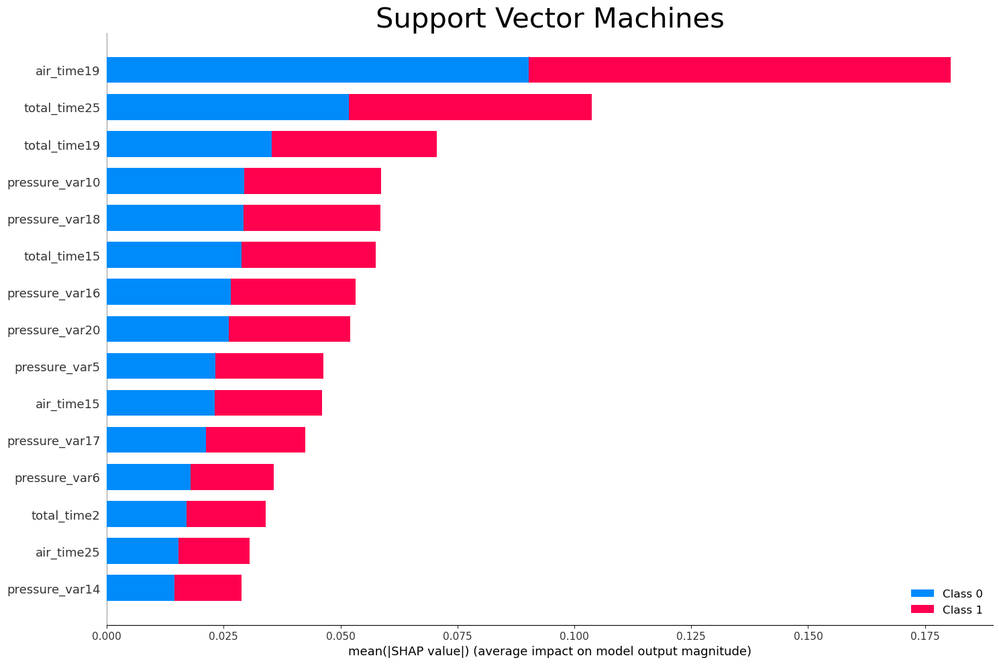

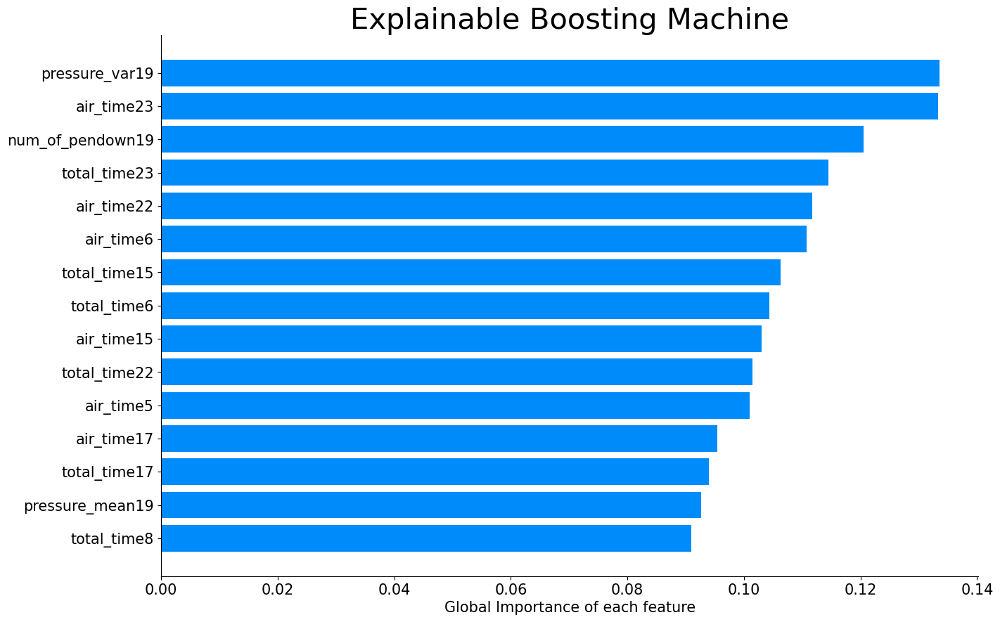

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

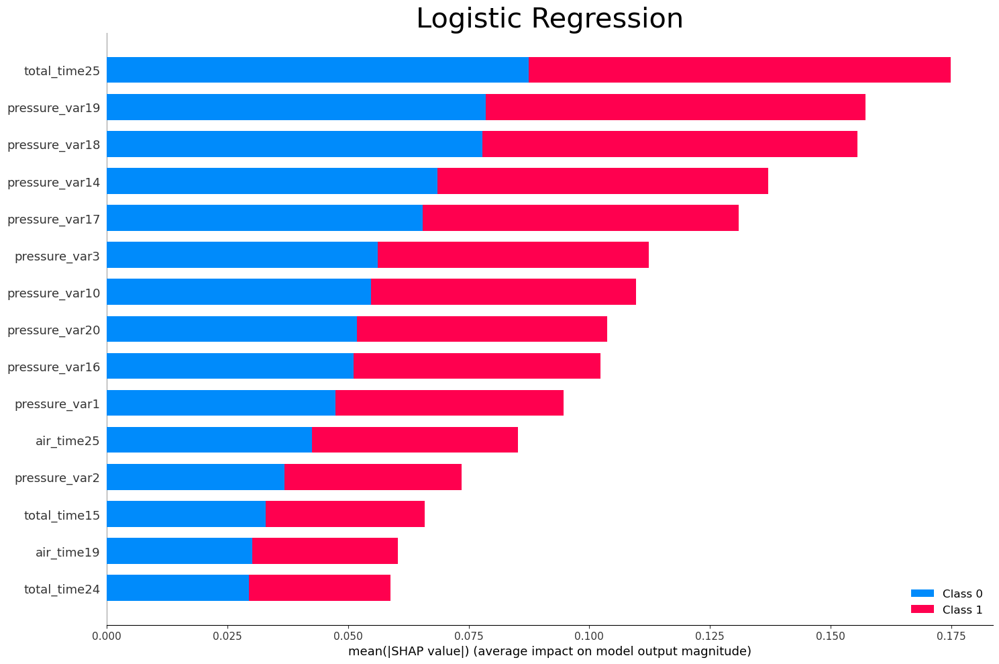

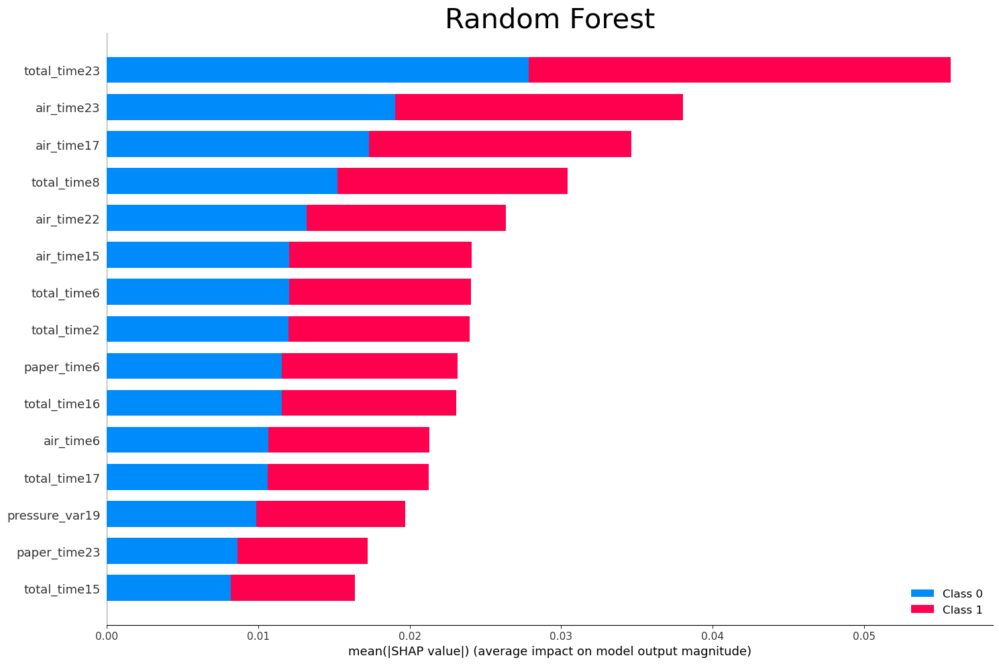

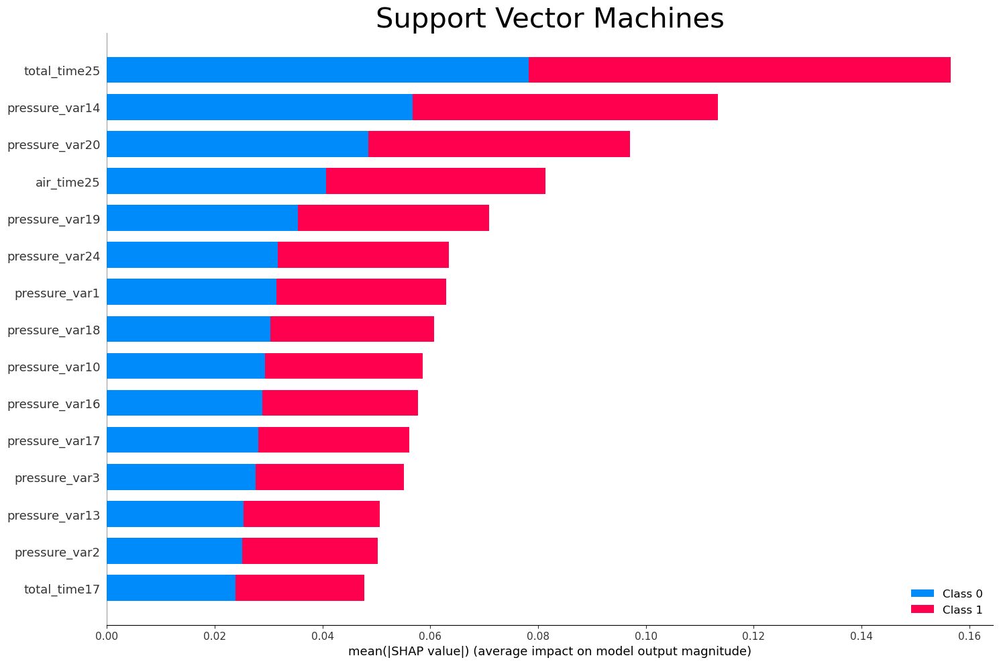

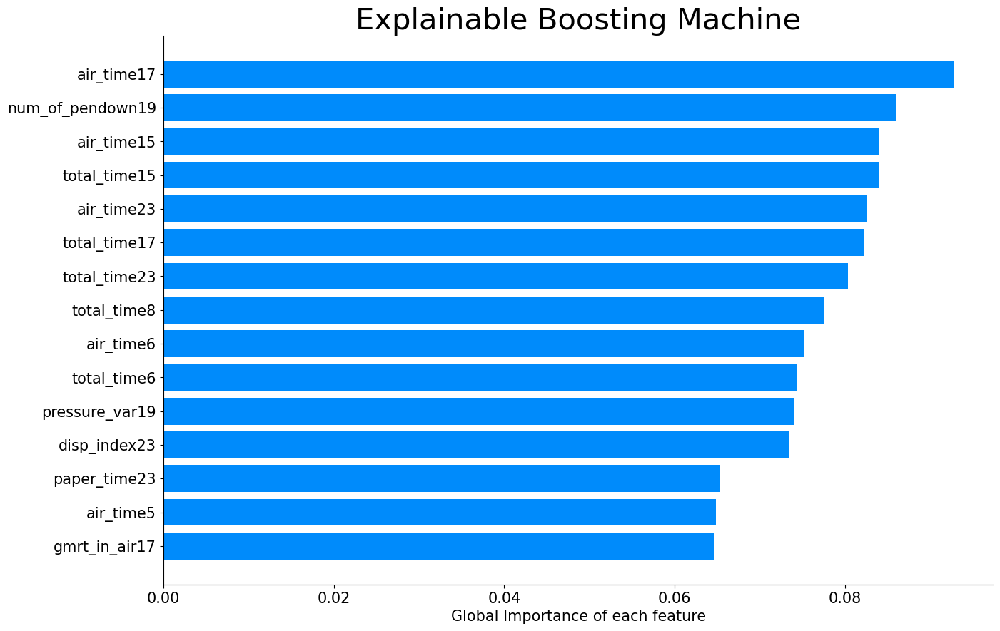

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

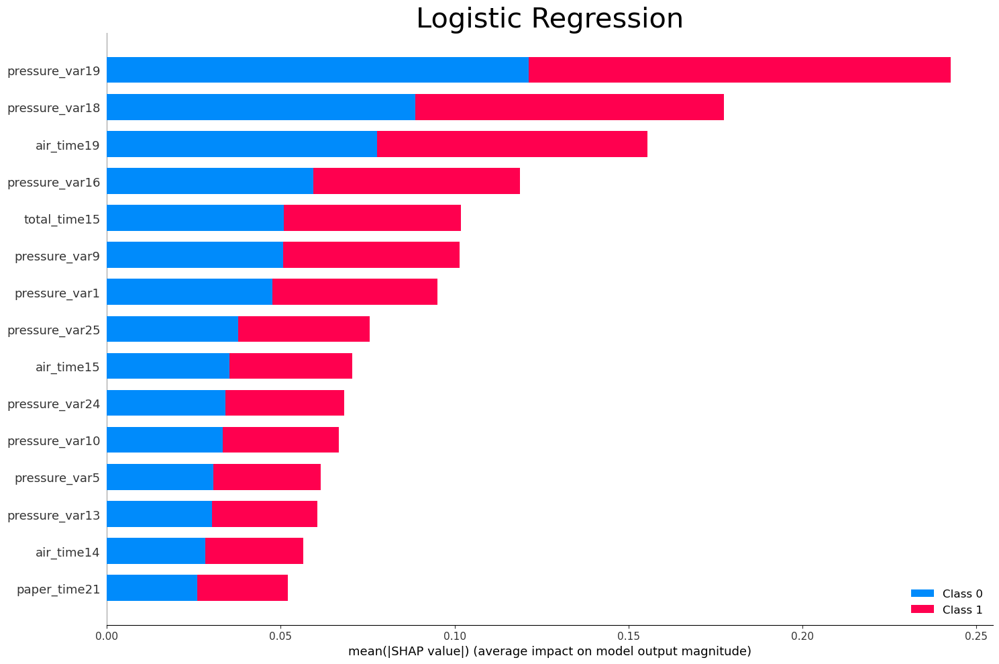

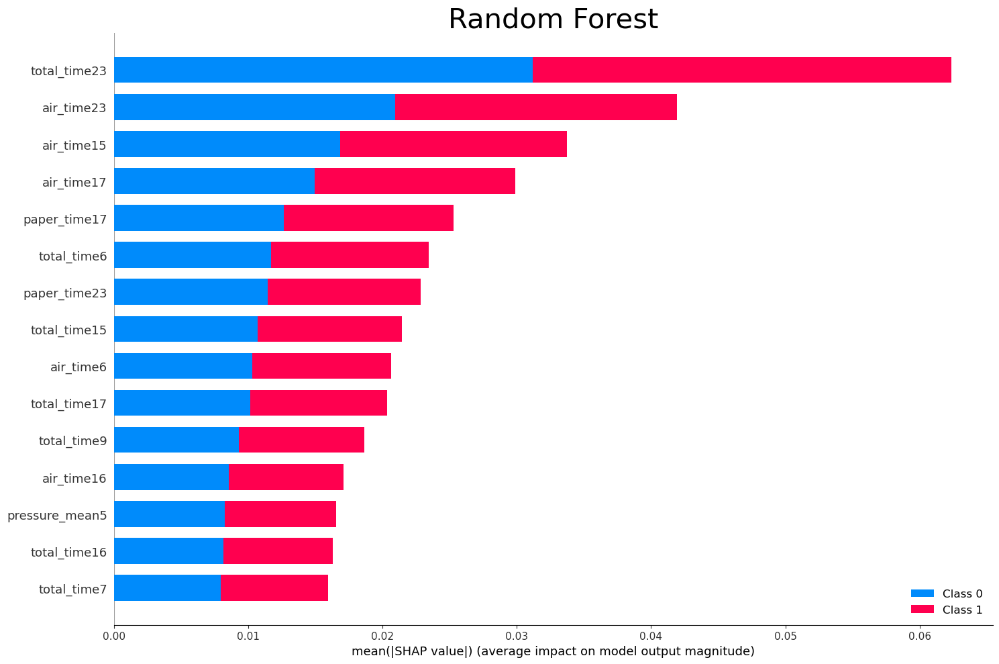

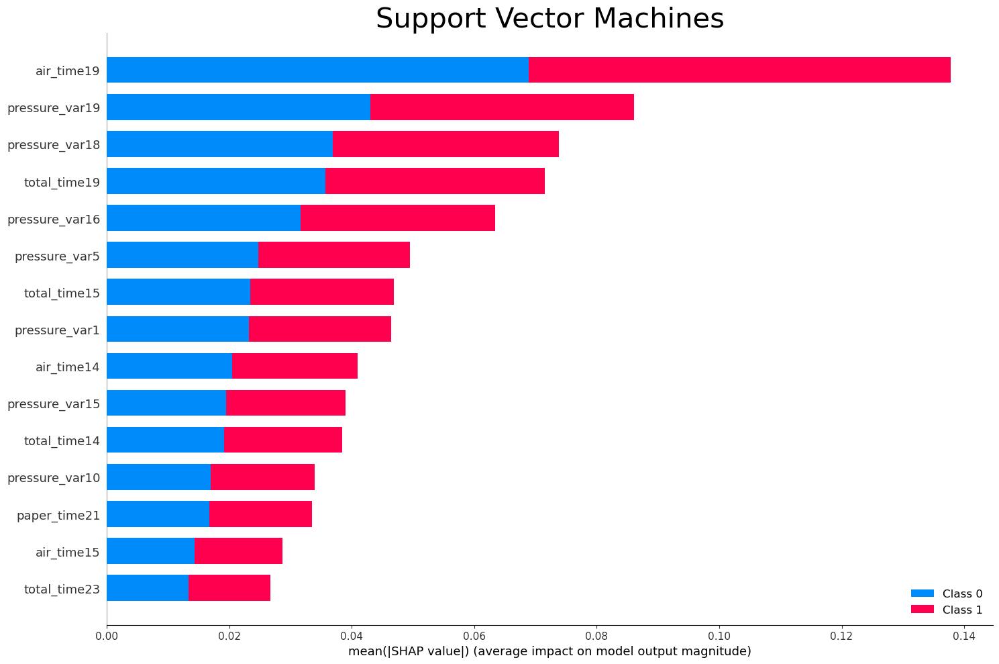

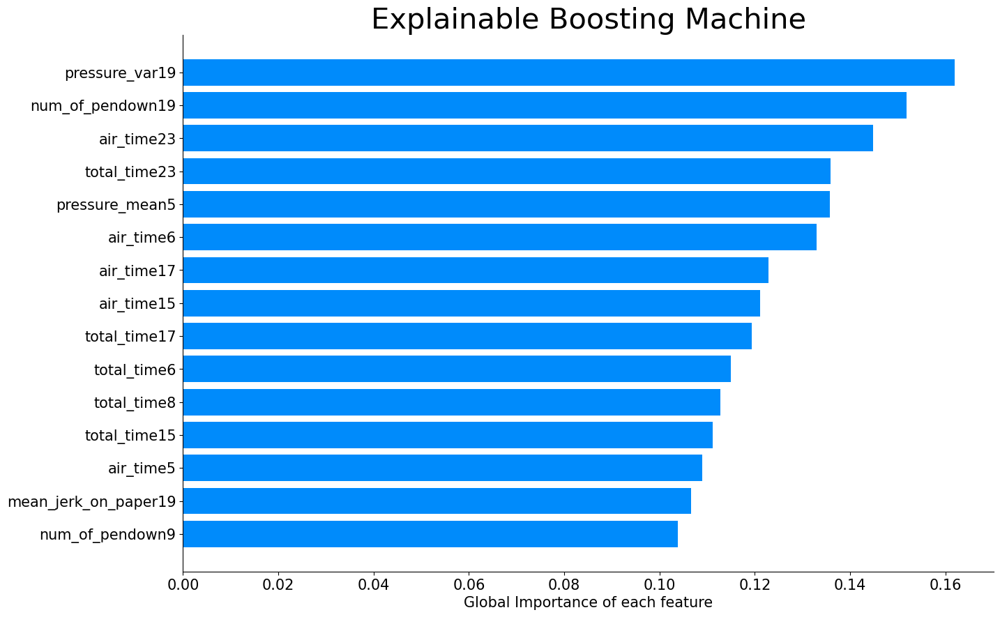

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

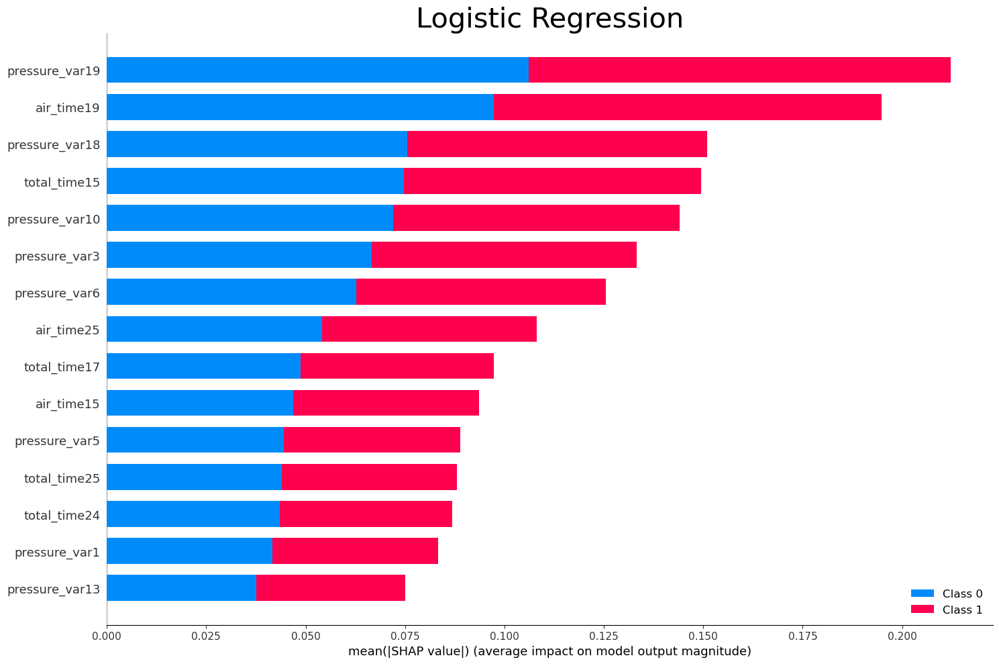

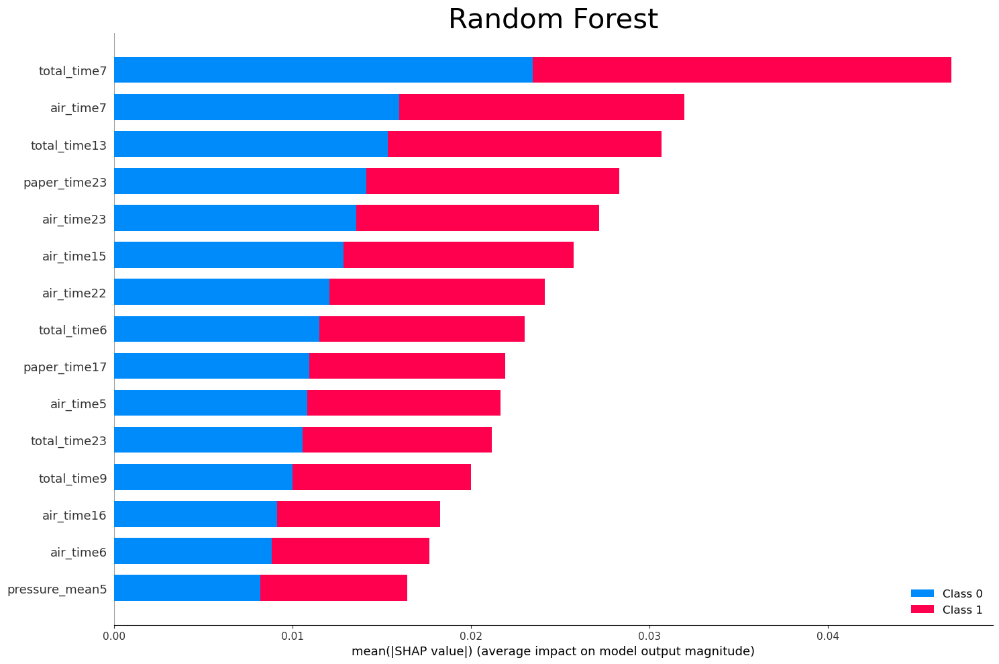

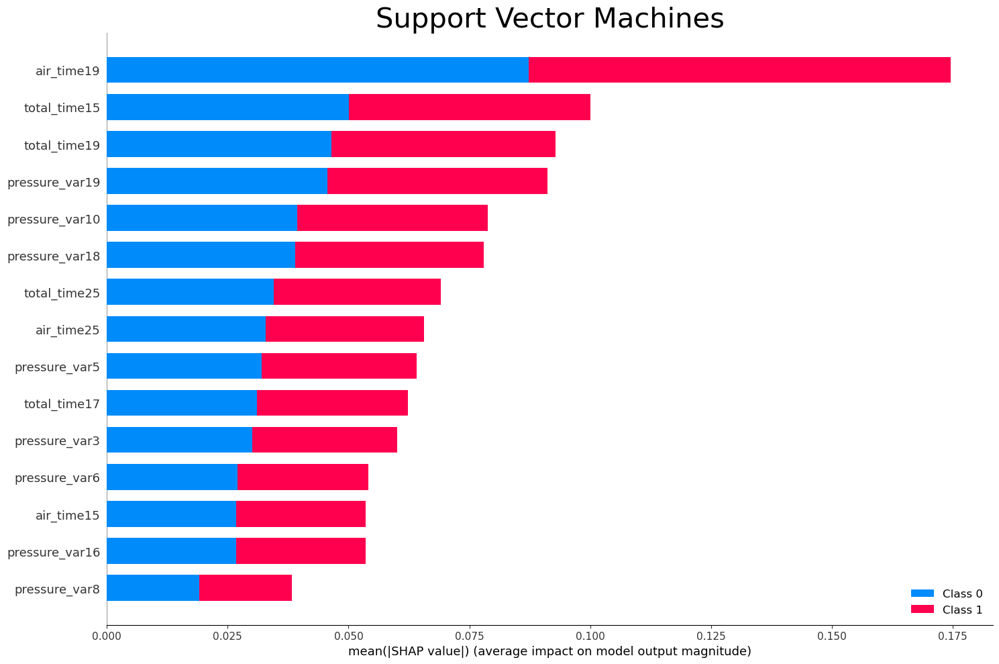

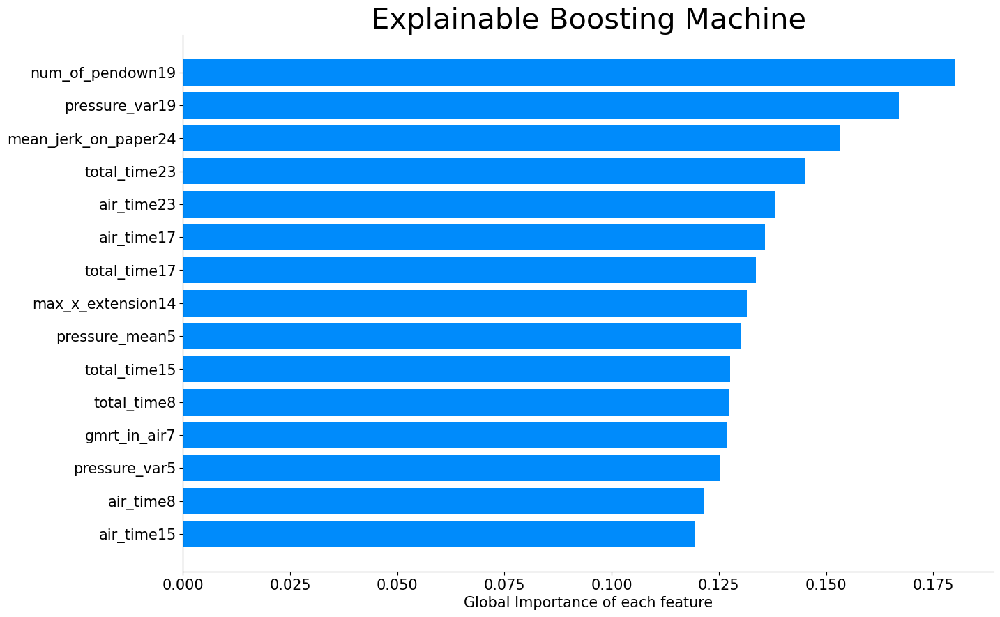

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

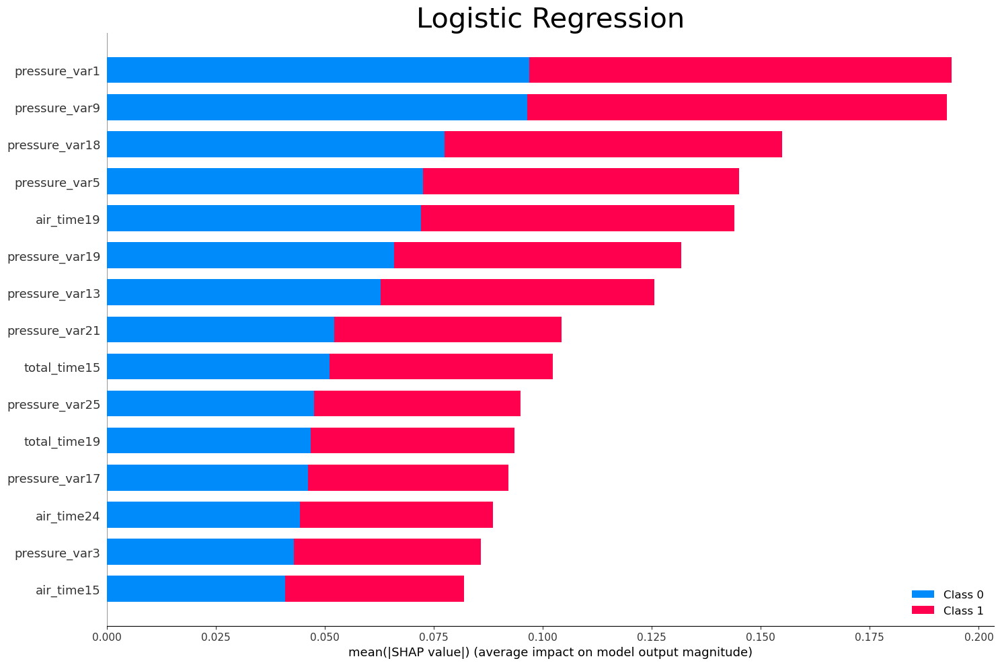

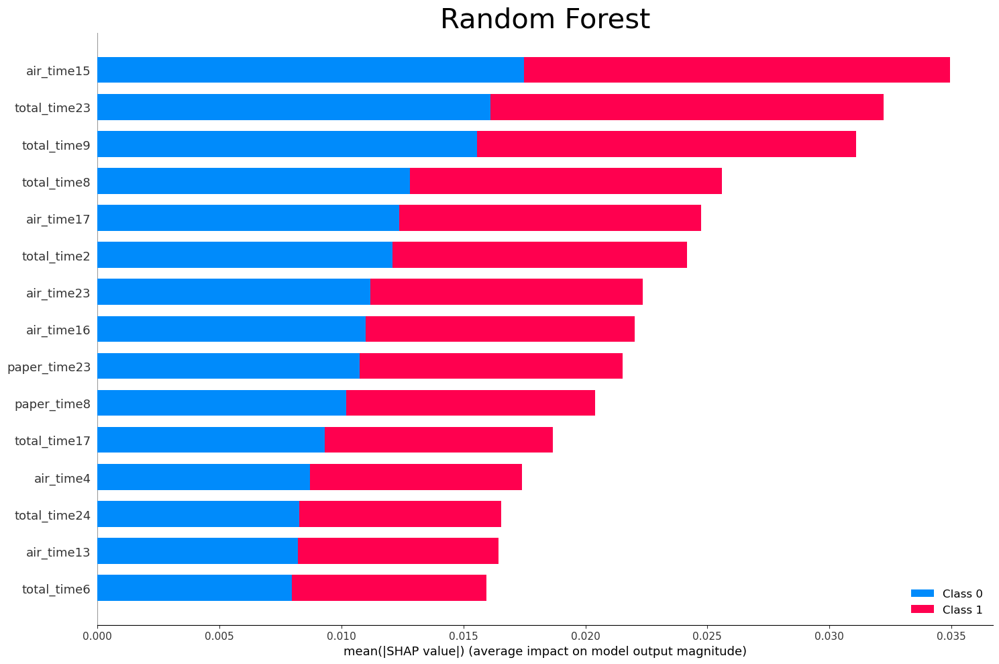

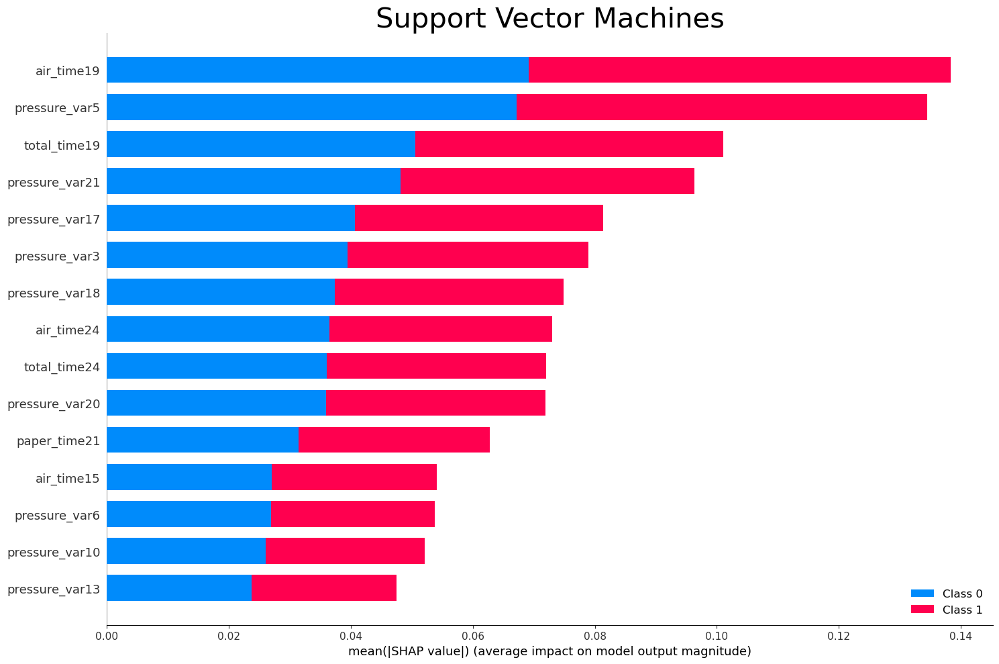

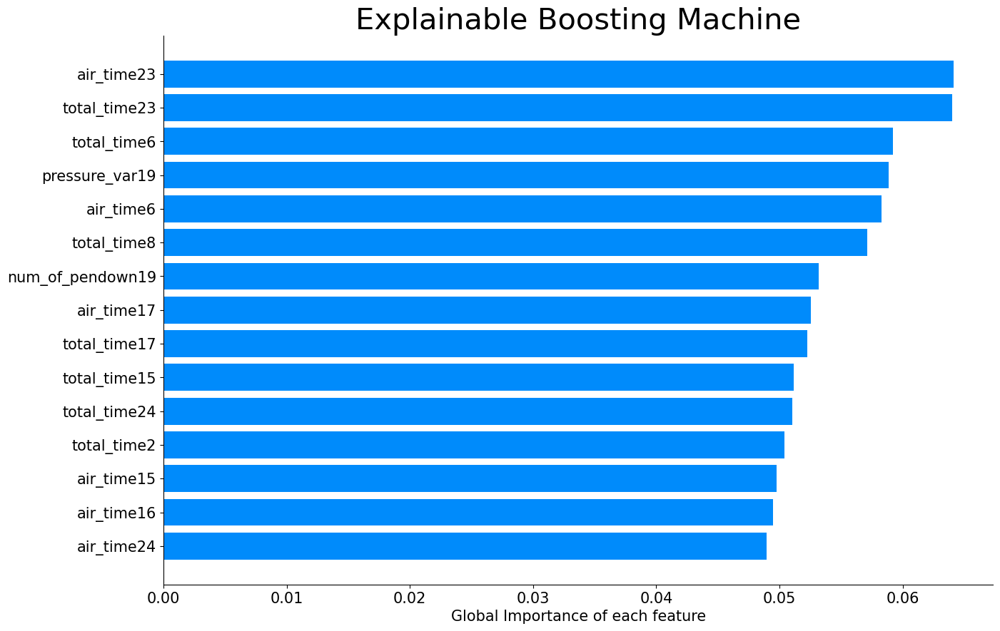

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

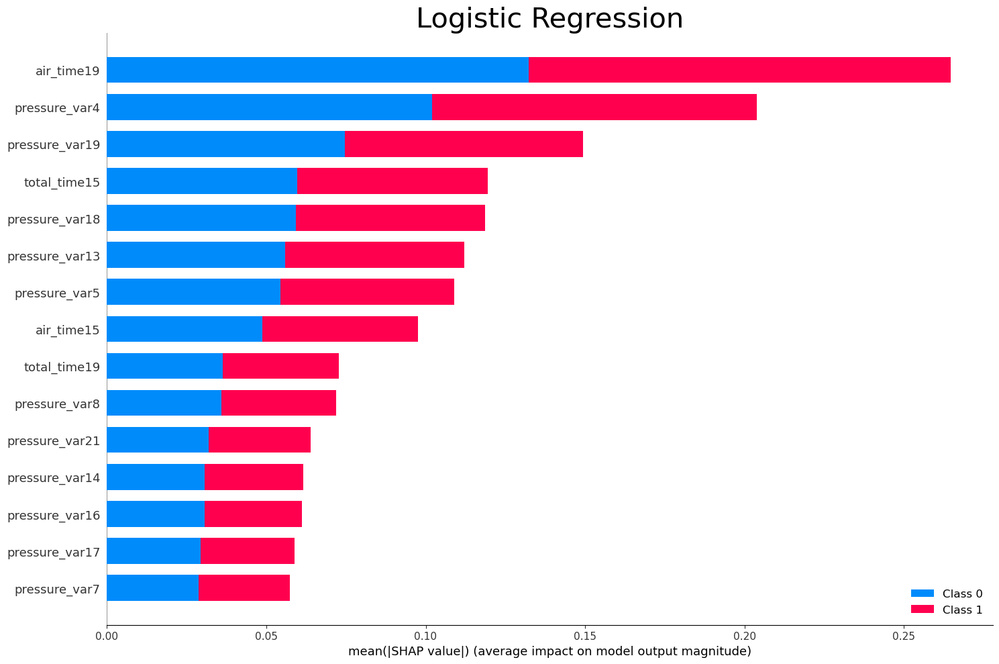

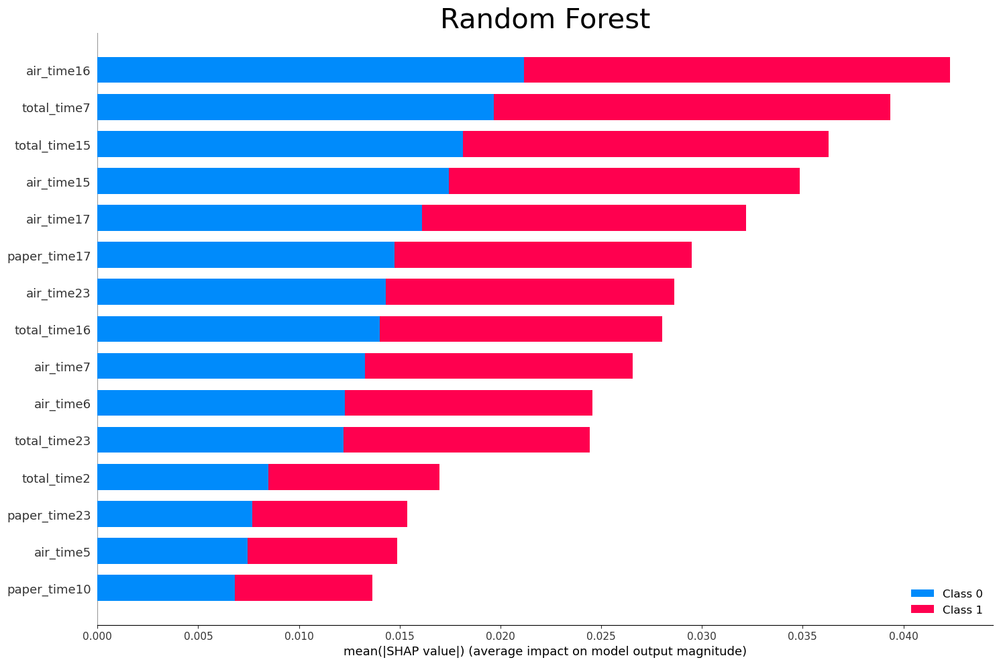

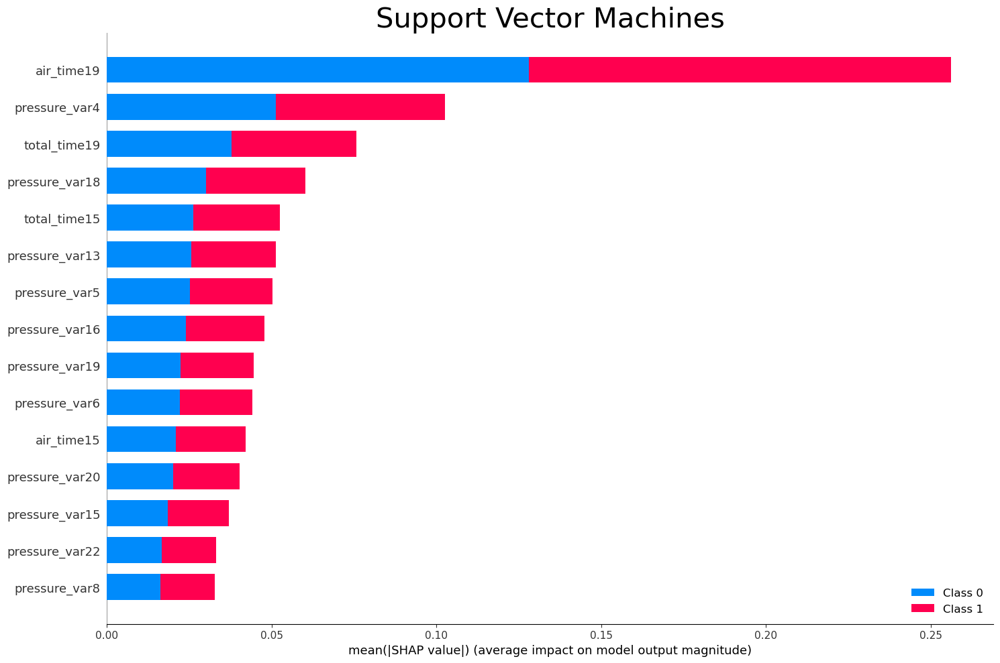

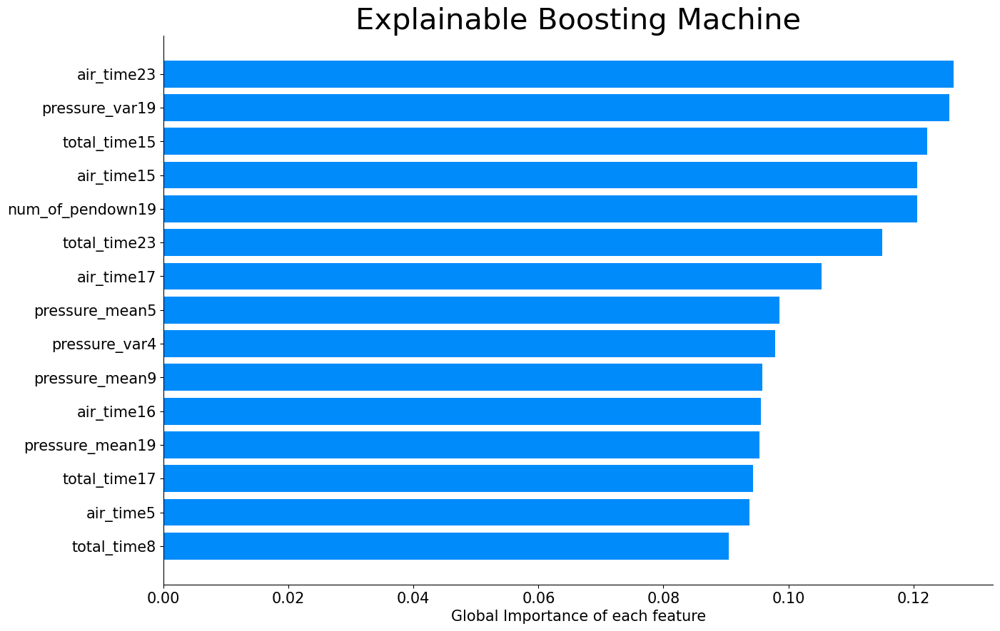

In [47]:
for i in range(sss_nsplits):
    lr_shap_global_values = lr_shaps[i].shap_values(X_tests_pd[i])
    rf_shap_global_values = rf_shaps[i].shap_values(X_tests_pd[i])
    svm_shap_global_values = svm_shaps[i].shap_values(X_tests_pd[i])
    
    global_shap_values = [lr_shap_global_values,
                          rf_shap_global_values,
                          svm_shap_global_values]
    
    ebm_global = ebm_clfs[i].explain_global()

    visual.global_shap(global_shap_values,
                       X_tests_pd[i],
                       ebm_global.data(),
                       nrows = 2,
                       ncols = 2,
                       figsize = (15, 10),
                       title_size = 30,
                       label_size = 15,
                       titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                       ebm_colors = shap_colors/255,
                       num_features=15,
                       save_name=f"{logs_dir}/darwin_global_SHAP_EBM_{i}")
    
    plt.show()